In [1]:
# Full library list and version numbers

print('This notebook was prepared using:')

import sys
print('python version %s' % sys.version)

import numpy as np
print('numpy version %s' % np.__version__)

import seaborn as sns
print('seaborn version %s' % sns.__version__)

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.gridspec import GridSpec
print('matplotlib version %s' % matplotlib.__version__)

import mplot as mp  # See mplot.py in the current directory

import scipy
from scipy import stats
print('scipy version %s' % scipy.__version__)

import pickle
print('pickle version %s' % pickle.format_version)

import importlib

import lolipop_helper
import figures as FIG
import PALTEanalysis
import tobramycin_analysis

sys.path.append('../paper-clade-reconstruction/src')
import MPL as MPL
import analyze_and_plot as AP
import reconstruct_clades as RC
import infer_fitness as IF
import print_info as PI
import LTEE
import LTEE_helper as LH

# GitHub directories
DATA_DIR = './data'
FIG_DIR = './figures'
LOCAL_JOBS_DIR = './data/local_jobs'
SIMULATION_DIR = './data/simulation'
SIMULATION_DIR_REL = '../simulation'

LOLIPOP_JOBS_DIR = './data/lolipop/jobs'
LOLIPOP_INPUT_DIR = './data/lolipop/input'
LOLIPOP_OUTPUT_DIR = './data/lolipop/output'
LOLIPOP_PARSED_OUTPUT_DIR = './data/lolipop/parsed_output'

CLUSTER_JOBS_DIR = './data/cluster_jobs'
LTEE_TRAJ_DIR = './data/LTEE_trajectories'
CLUSTERIZATION_OUTPUT_DIR = './data/clusterization_output'
RECONSTRUCTION_OUTPUT_DIR = './data/reconstruction_output'

LTEE_TRAJ_DIR_REL = '../LTEE_trajectories'
CLUSTERIZATION_OUTPUT_DIR_REL = '../clusterization_output'

METHODS = FIG.METHODS

This notebook was prepared using:
python version 3.6.10 |Anaconda, Inc.| (default, Mar 25 2020, 18:53:43) 
[GCC 4.2.1 Compatible Clang 4.0.1 (tags/RELEASE_401/final)]
numpy version 1.19.1
seaborn version 0.11.0
matplotlib version 3.3.2
scipy version 1.5.2
pickle version 4.0


In [2]:
def reload():
    importlib.reload(AP)
    importlib.reload(RC)
    importlib.reload(IF)
    importlib.reload(LH)
    importlib.reload(PI)
    importlib.reload(lolipop_helper)
    importlib.reload(FIG)
    importlib.reload(PALTEanalysis)
    importlib.reload(tobramycin_analysis)
    importlib.reload(mp)
reload()

In [3]:
def resetPlottingParams():
    PARAMS = {'text.usetex': False, 'mathtext.fontset': 'stixsans', 'mathtext.default': 'regular', 'pdf.fonttype': 42, 'ps.fonttype': 42}
    plt.rcParams.update(matplotlib.rcParamsDefault)
    plt.rcParams.update(PARAMS)

In [4]:
resetPlottingParams()

In [5]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

# Generate simulated data

In [50]:
def generate_shell_script_local(path2job, jobname, command):
    fp = open(path2job + '/' + jobname + '.sh', 'w')
    fp.write('#!/bin/sh\n')
    fp.write(f'# {jobname}\n')
    fp.write(command)
    fp.close()

    
def generate_command(N=1000, T=1000, start_n=0, num_trials=20, meanS=0.03, stdS=0.01, mu=0.0005, threshold=0.05, 
                     minS=0.01, maxS=0.04,
                     uniform=False, covariance=True, covAtEachTime=True, saveCompleteResults=False, verbose=True):
    command = ''
    for n in np.arange(start_n, start_n + num_trials):
        if uniform:
            output_file = f'{SIMULATION_DIR_REL}/simulation_output_min={minS}_max={maxS}_mu={mu}_th={threshold}_n={n}'
        else:
            output_file = f'{SIMULATION_DIR_REL}/simulation_output_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}'
        job_pars = {'-o': output_file,
                    '-N': N,
                    '-T': T,
                    '--mu': mu,
                    '--meanS': meanS,
                    '--stdS': stdS,
                    '--minS': minS,
                    '--maxS': maxS,
                    '--threshold': threshold,
                    }
        if uniform:
            job_pars['--uniform'] = ''
        if covariance:
            job_pars['--covariance'] = ''
        if covAtEachTime:
            job_pars['--covAtEachTime'] = ''
        if saveCompleteResults:
            job_pars['--saveCompleteResults'] = ''
        if verbose:
            job_pars['--verbose'] = ''
        command += 'python ../../simulate_evolution.py '
        command += ' '.join([k + ' ' + str(v) for k, v in job_pars.items()])
        command += '\n'
    return command

In [55]:
def plot_simulation(start_n=0, meanS=0.03, stdS=0.01, mu=0.001, threshold=0.05, 
                    num_trials=20, nCol=5, hspace=0.2, highlight=[], 
                    minS=0.01, maxS=0.04, uniform=False,
                    winnerIsNew=False, wildtypeIsBackground=False, figsize=(20, 15), fontsize=15):
    importlib.reload(AP)
    nRow = num_trials // nCol + (1 if num_trials % nCol != 0 else 0)
    fig, axes = plt.subplots(nRow, nCol, figsize=figsize)
    for n in np.arange(start_n, start_n + num_trials):
        plt.sca(axes[(n-start_n)//5, (n-start_n)%5])
        if uniform:
            filename = f'{SIMULATION_DIR}/simulation_output_min={minS}_max={maxS}_mu={mu}_th={threshold}_n={n}.npz'
        else:
            filename = f'{SIMULATION_DIR}/simulation_output_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.npz'
        dic = np.load(filename, allow_pickle=True)
        seqOnceEmerged, freqOnceEmerged, pop = AP.getDominantGenotypeTrajectories(dic, T=T+1, threshold=0, totalPopulation=N)
        if winnerIsNew:
            clade, cladeFreq = AP.getCladeMutsWinnerIsNew(dic, seqOnceEmerged, freqOnceEmerged)
        elif wildtypeIsBackground:
            clade, cladeFreq = AP.getCladeMutsWildtypeIsBackground(seqOnceEmerged, freqOnceEmerged)
        else:
            clade, cladeFreq = AP.getCladeMuts(seqOnceEmerged, freqOnceEmerged)
        AP.plotCladeFreq(cladeFreq, plotLegend=False, plotShow=False)
        at_left = ((n-start_n) % 5 == 0)
        at_bottom = ((n-start_n) // 5 == nRow - 1)
        plt.ylabel('clade frequency' if at_left else '', fontsize=fontsize/1.3, labelpad=5)
        if not at_left:
            plt.yticks(ticks=[], labels=[])
        plt.xlabel('generation' if at_bottom else '', fontsize=fontsize/1.3, labelpad=5)
        if not at_bottom:
            plt.xticks(ticks=[], labels=[])
        plt.title(f"n={n}; {len(cladeFreq)} clades; {len(dic['traj'][0])} muts", fontsize=fontsize)
        if n in highlight:
            ax = plt.gca().axis()
            rec = Rectangle((ax[0]-0.7, ax[2]), ax[1]-ax[0], ax[3]-ax[2], fill=False, lw=3, color='red')
            rec = plt.gca().add_patch(rec)
            rec.set_clip_on(False)
        else:
            plt.gca().tick_params(color='gray', labelcolor='black')
            for spine in plt.gca().spines.values():
                spine.set_edgecolor('gray')
    plt.subplots_adjust(hspace=hspace)
    plt.show()
    

In [51]:
N, T, num_trials = 1000, 1000, 40

In [52]:
meanS, stdS = 0.03, 0.01
mu, threshold = 2e-4, 0.05
command = generate_command(N=N, T=T, num_trials=num_trials, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
jobname = f'simulation_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_local_submission'
generate_shell_script_local(LOCAL_JOBS_DIR, jobname, command)


In [105]:
meanS, stdS = 0, 0.015
mu, threshold = 2e-3, 0.05
command = generate_command(N=N, T=T, num_trials=num_trials, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
jobname = f'simulation_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_local_submission'
generate_shell_script_local(LOCAL_JOBS_DIR, jobname, command)


In [111]:
meanS, stdS = -0.02, 0.02
mu, threshold = 2e-3, 0.05
command = generate_command(N=N, T=T, num_trials=num_trials, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
jobname = f'simulation_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_local_submission'
generate_shell_script_local(LOCAL_JOBS_DIR, jobname, command)


In [119]:
meanS, stdS = -0.02, 0.02
mu, threshold = 5e-3, 0.05
command = generate_command(N=N, T=T, num_trials=num_trials, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold)
jobname = f'simulation_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_local_submission'
generate_shell_script_local(LOCAL_JOBS_DIR, jobname, command)


In [99]:
minS, maxS = 0.01, 0.04
mu, threshold = 5e-4, 0.05
command = generate_command(N=N, T=T, num_trials=num_trials, minS=minS, maxS=maxS, mu=mu, threshold=threshold, 
                           uniform=True)
jobname = f'simulation_min={minS}_max={maxS}_mu={mu}_th={threshold}_local_submission'
generate_shell_script_local(LOCAL_JOBS_DIR, jobname, command)


In [126]:
minS, maxS = -0.06, 0.03
mu, threshold = 1e-3, 0.05
command = generate_command(N=N, T=T, num_trials=num_trials, minS=minS, maxS=maxS, mu=mu, threshold=threshold, 
                           uniform=True)
jobname = f'simulation_min={minS}_max={maxS}_mu={mu}_th={threshold}_local_submission'
generate_shell_script_local(LOCAL_JOBS_DIR, jobname, command)


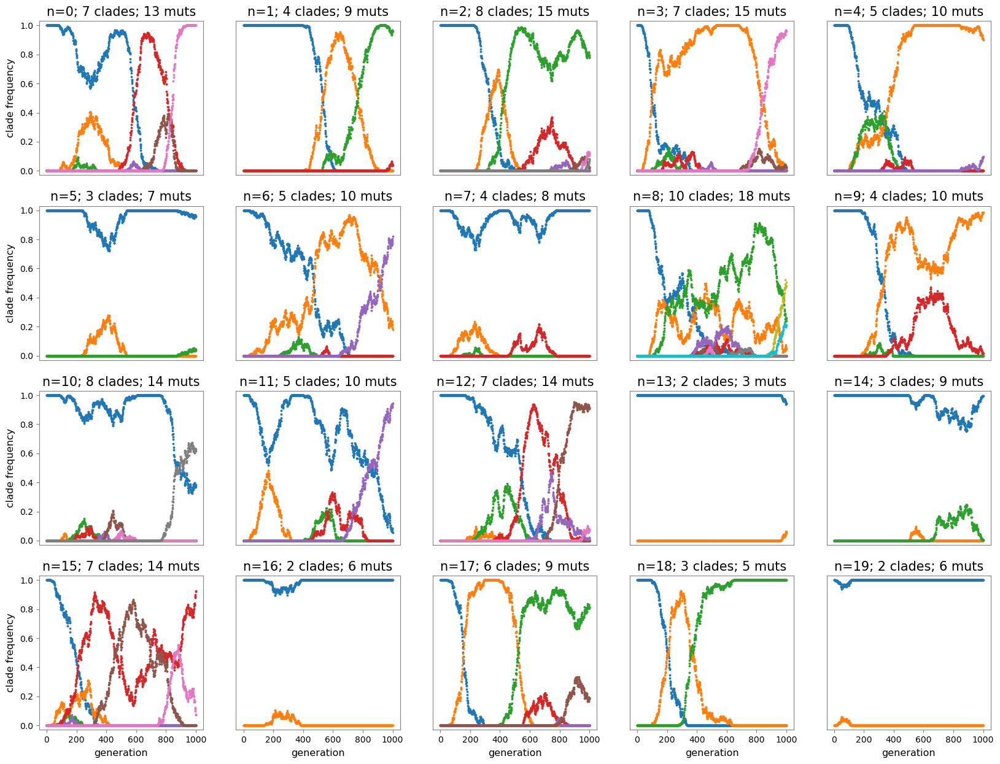

In [57]:
print(f'meanS={meanS}, stdS={stdS}')
plot_simulation(mu=mu, meanS=meanS, stdS=stdS, uniform=False)

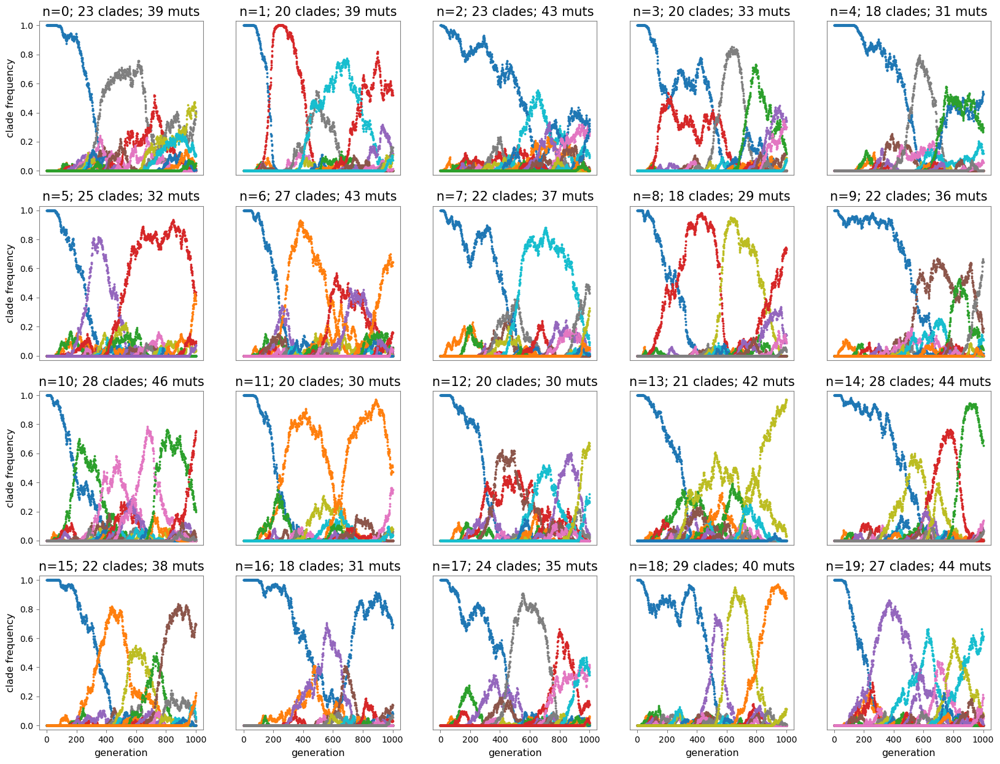

In [106]:
print(f'meanS={meanS}, stdS={stdS}')
plot_simulation(mu=mu, meanS=meanS, stdS=stdS, uniform=False)

meanS=-0.02, stdS=0.02


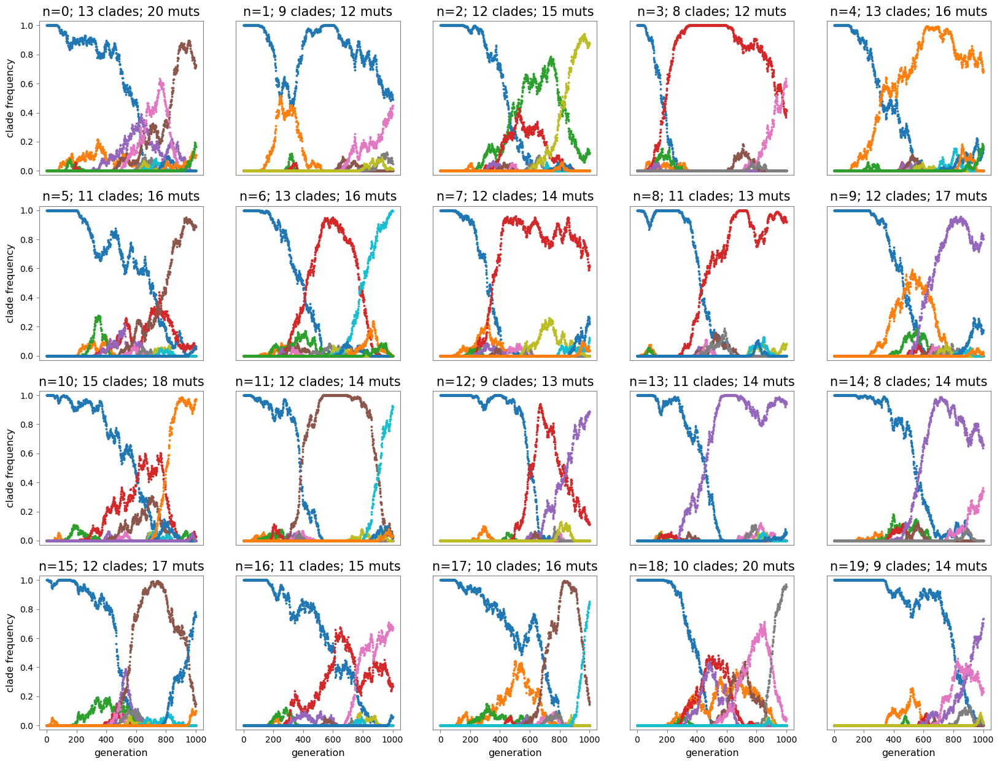

In [112]:
print(f'meanS={meanS}, stdS={stdS}')
plot_simulation(mu=mu, meanS=meanS, stdS=stdS, uniform=False)

meanS=-0.02, stdS=0.02, mu=0.005


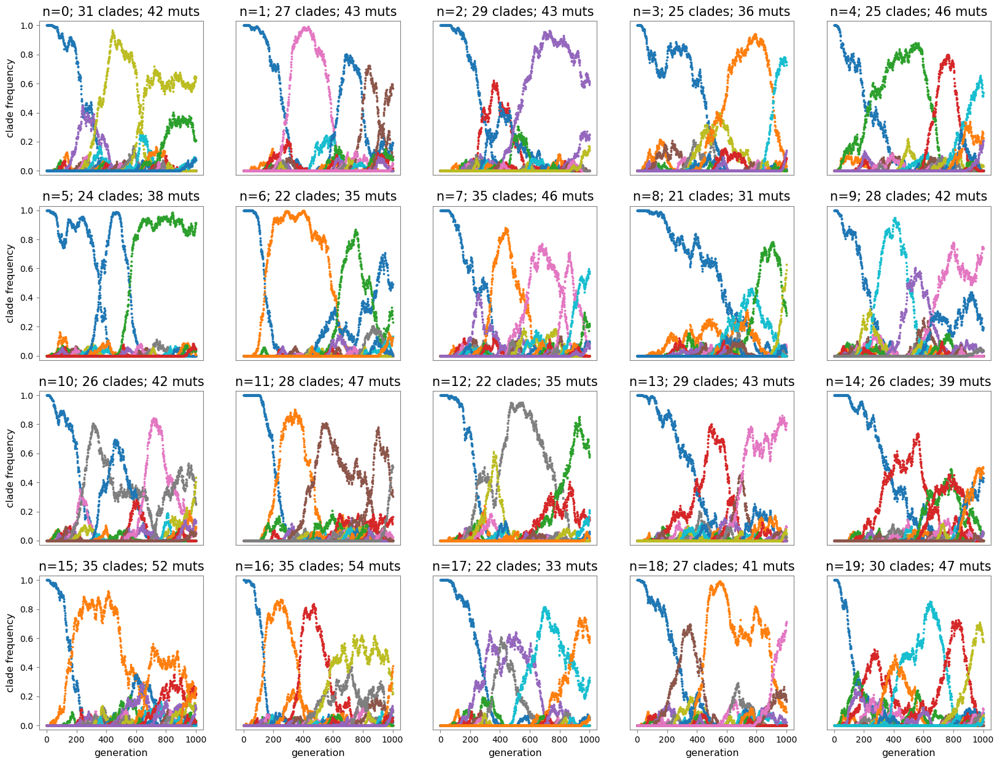

In [122]:
print(f'meanS={meanS}, stdS={stdS}, mu={mu}')
plot_simulation(mu=mu, meanS=meanS, stdS=stdS, uniform=False)

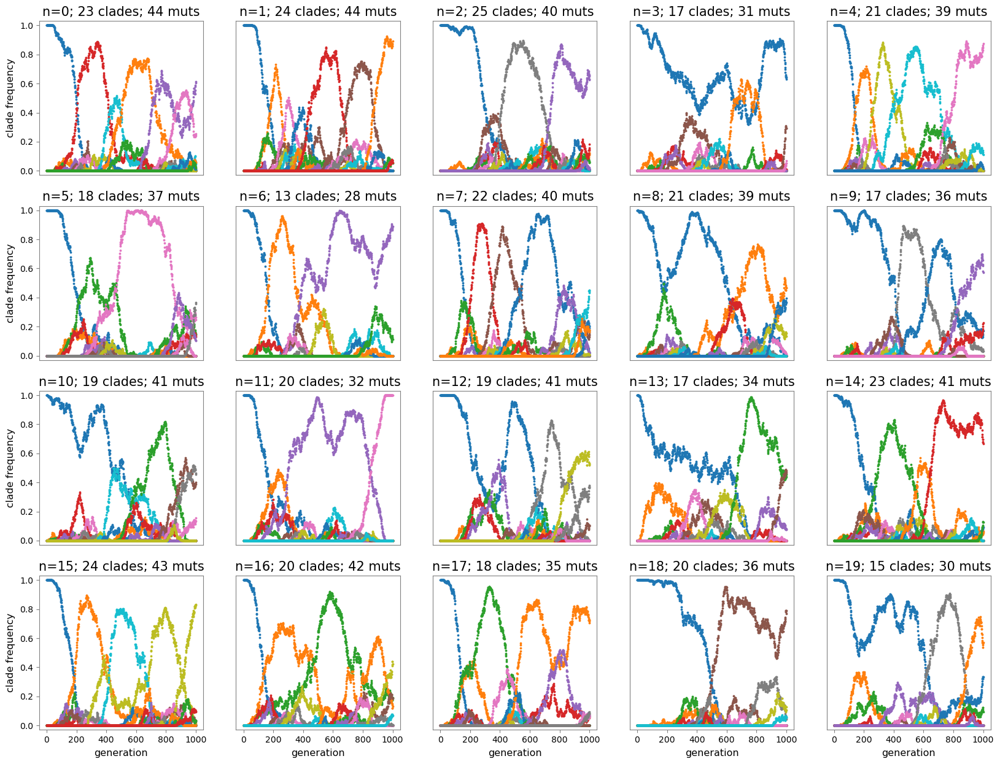

In [95]:
print(f'minS={minS}, maxS={maxS}, mu={mu}')
plot_simulation(mu=mu, minS=minS, maxS=maxS, uniform=True)

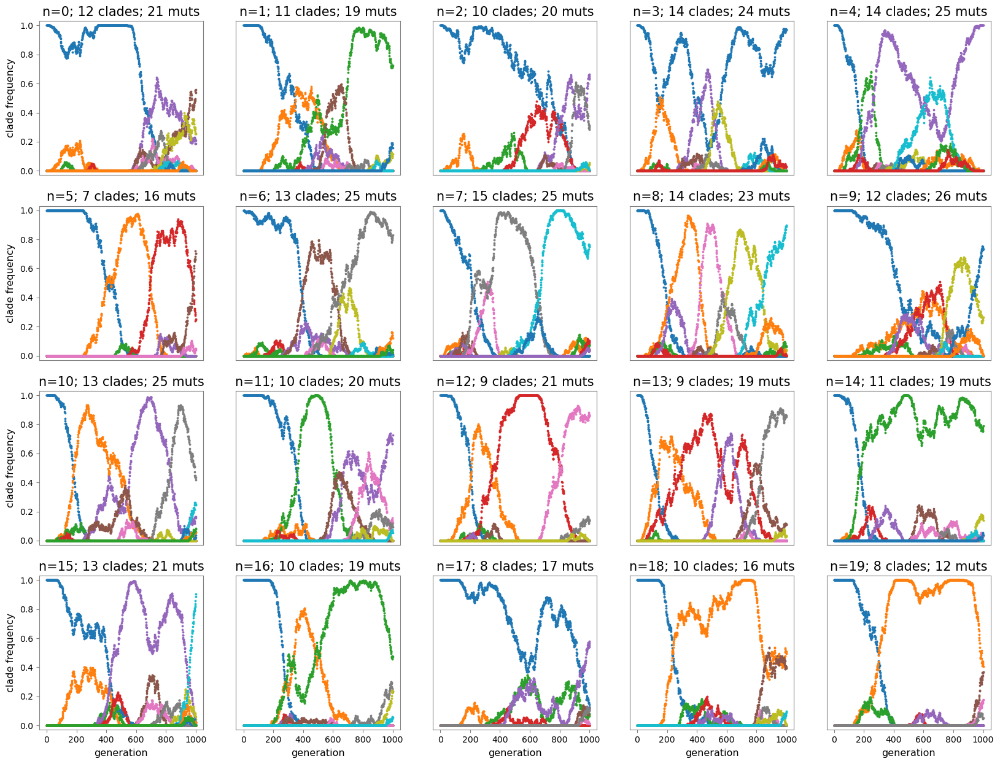

In [100]:
print(f'minS={minS}, maxS={maxS}, mu={mu}')
plot_simulation(mu=mu, minS=minS, maxS=maxS, uniform=True)

minS=-0.06, maxS=0.03, mu=0.001


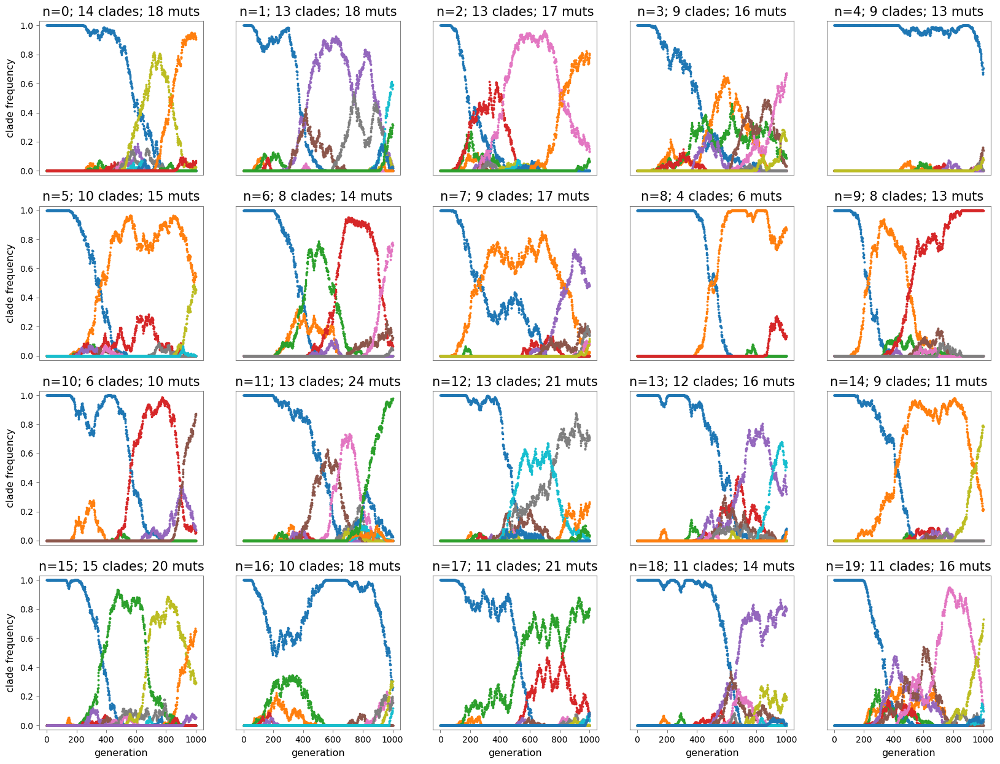

In [127]:
print(f'minS={minS}, maxS={maxS}, mu={mu}')
plot_simulation(mu=mu, minS=minS, maxS=maxS, uniform=True)

# Lolipop on simulated data

## Create tables as input to Lolipop

In [85]:
def create_tables_for_Lolipop(num_trials=40, meanS=0.03, stdS=0.01, minS=0.01, maxS=0.04, uniform=False, mu=2e-4, threshold=0.05):
    for n in range(num_trials):
        sim = lolipop_helper.loadSimulation(n, meanS=meanS, stdS=stdS, minS=minS, maxS=maxS, uniform=uniform, mu=mu, threshold=threshold)
        if uniform:
            filename = f'simulation_traj_min={minS}_max={maxS}_mu={mu}_th={threshold}_n={n}.tsv'
        else:
            filename = f'simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}.tsv'
            
        lolipop_helper.saveTrajectoriesToTables(sim['traj'], LOLIPOP_INPUT_DIR + f'/{filename}', sep='\t')
        

In [68]:
%%time
reload()
create_tables_for_Lolipop()

CPU times: user 2.81 s, sys: 37.4 ms, total: 2.85 s
Wall time: 2.87 s


In [107]:
%%time
reload()
create_tables_for_Lolipop(meanS=0, stdS=0.015, mu=2e-3)

CPU times: user 4.19 s, sys: 165 ms, total: 4.36 s
Wall time: 4.62 s


In [114]:
%%time
reload()
create_tables_for_Lolipop(meanS=-0.02, stdS=0.02, mu=2e-3)

CPU times: user 3.09 s, sys: 51.3 ms, total: 3.15 s
Wall time: 3.17 s


In [120]:
%%time
reload()
create_tables_for_Lolipop(meanS=-0.02, stdS=0.02, mu=5e-3)

CPU times: user 4.25 s, sys: 227 ms, total: 4.48 s
Wall time: 4.76 s


In [101]:
%%time
reload()
create_tables_for_Lolipop(mu=mu, uniform=True)

CPU times: user 3.39 s, sys: 129 ms, total: 3.52 s
Wall time: 3.7 s


In [128]:
%%time
reload()
create_tables_for_Lolipop(mu=1e-3, minS=-0.06, maxS=0.03, uniform=True)

CPU times: user 3.24 s, sys: 129 ms, total: 3.37 s
Wall time: 3.75 s


## Run lolipop in command line

`
lolipop lineage --input [input filename] --output [output folder]
`

In [81]:
def create_job_file_for_Lolipop(jobname, num_trials=40, meanS=0.03, stdS=0.01, minS=0.01, maxS=0.04, uniform=False, mu=2e-4, threshold=0.05):
    
    with open(f'{LOLIPOP_JOBS_DIR}/{jobname}', 'w') as fp:
        fp.write('#!/bin/sh\n')
        for n in range(num_trials):
            fp.write(lolipop_helper.generate_lolipop_command_for_simulated_data(n, uniform=uniform, minS=minS, maxS=maxS, meanS=meanS, stdS=stdS, mu=mu, threshold=threshold) + '\n')

        

In [79]:
with open(f'{LOLIPOP_JOBS_DIR}/create_directories', 'w') as fp:
    fp.write('#!/bin/sh\n')
    for n in range(num_trials):
        fp.write(f'mkdir ../output/n={n}_uniform' + '\n')

In [108]:
with open(f'{LOLIPOP_JOBS_DIR}/create_directories', 'w') as fp:
    fp.write('#!/bin/sh\n')
    for n in range(num_trials):
        fp.write(f'mkdir ../output/n={n}_zeroMean' + '\n')

In [82]:
reload()
jobname = 'lolipop_simulated_data.sh'
create_job_file_for_Lolipop(jobname)

In [109]:
reload()
jobname = 'lolipop_simulated_data_zeroMean.sh'
create_job_file_for_Lolipop(jobname, meanS=0, stdS=0.015, mu=2e-3)

In [116]:
reload()
jobname = 'lolipop_simulated_data_negativeMean.sh'
create_job_file_for_Lolipop(jobname, meanS=-0.02, stdS=0.02, mu=2e-3)

In [121]:
reload()
jobname = 'lolipop_simulated_data_negativeMean.sh'
create_job_file_for_Lolipop(jobname, meanS=-0.02, stdS=0.02, mu=5e-3)

In [102]:
reload()
jobname = 'lolipop_simulated_data_uniform.sh'
create_job_file_for_Lolipop(jobname, mu=mu, uniform=True)

In [129]:
reload()
jobname = 'lolipop_simulated_data_uniform.sh'
create_job_file_for_Lolipop(jobname, mu=1e-3, minS=-0.06, maxS=0.03, uniform=True)

### Save parsed output file

In [76]:
def save_parsed_output_for_Lolipop(num_trials=40, meanS=0.03, stdS=0.01, minS=0.01, maxS=0.04, uniform=False, mu=2e-4, threshold=0.05):
    for n in range(num_trials):
        if uniform:
            filename = f'simulation_traj_min={minS}_max={maxS}_mu={mu}_th={threshold}_n={n}'
            directory = f'{LOLIPOP_OUTPUT_DIR}/n={n}_uniform'
        else:
            filename = f'simulation_traj_mean={meanS}_std={stdS}_mu={mu}_th={threshold}_n={n}'
            directory = f'{LOLIPOP_OUTPUT_DIR}/n={n}'
        saveFile = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{filename}'
        lolipop_helper.parseOutput(directory, filename, saveFile=saveFile)
        print(f'n={n}', end='\t')

In [77]:
reload()
save_parsed_output_for_Lolipop()

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


n=0	n=1	n=2	n=3	n=4	n=5	n=6	n=7	n=8	n=9	n=10	n=11	n=12	n=13	n=14	n=15	n=16	n=17	n=18	n=19	n=20	n=21	n=22	n=23	n=24	n=25	n=26	n=27	n=28	n=29	n=30	n=31	n=32	n=33	n=34	n=35	n=36	n=37	n=38	n=39	

In [110]:
reload()
save_parsed_output_for_Lolipop(meanS=0, stdS=0.015, mu=2e-3)

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


n=0	n=1	n=2	n=3	n=4	n=5	n=6	n=7	n=8	n=9	n=10	n=11	n=12	n=13	n=14	n=15	n=16	n=17	n=18	n=19	n=20	n=21	n=22	n=23	n=24	n=25	n=26	n=27	n=28	n=29	n=30	n=31	n=32	n=33	n=34	n=35	n=36	n=37	n=38	n=39	

In [123]:
reload()
save_parsed_output_for_Lolipop(meanS=-0.02, stdS=0.02, mu=5e-3)

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


n=0	n=1	n=2	n=3	n=4	n=5	n=6	n=7	n=8	n=9	n=10	n=11	n=12	n=13	n=14	n=15	n=16	n=17	n=18	n=19	n=20	n=21	n=22	n=23	n=24	n=25	n=26	n=27	n=28	n=29	n=30	n=31	n=32	n=33	n=34	n=35	n=36	n=37	n=38	n=39	

In [103]:
reload()
save_parsed_output_for_Lolipop(mu=mu, uniform=True)

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


n=0	n=1	n=2	n=3	n=4	n=5	n=6	n=7	n=8	n=9	n=10	n=11	n=12	n=13	n=14	n=15	n=16	n=17	n=18	n=19	n=20	n=21	n=22	n=23	n=24	n=25	n=26	n=27	n=28	n=29	n=30	n=31	n=32	n=33	n=34	n=35	n=36	n=37	n=38	n=39	

In [130]:
reload()
save_parsed_output_for_Lolipop(mu=mu, minS=-0.06, maxS=0.03, uniform=True)

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


n=0	n=1	n=2	n=3	n=4	n=5	n=6	n=7	n=8	n=9	n=10	n=11	n=12	n=13	n=14	n=15	n=16	n=17	n=18	n=19	n=20	n=21	n=22	n=23	n=24	n=25	n=26	n=27	n=28	n=29	n=30	n=31	n=32	n=33	n=34	n=35	n=36	n=37	n=38	n=39	

# Reconstruction on real datasets

## Reconstruction on LTEE data

In [6]:
def generate_shell_script(path2job, jobname, command, hours=4, mem=16, ncpus=1, env='env_pySCA'):
    """Generates a shell script to run on HPCC cluster."""
    
    fp=open(path2job + '/' + jobname + '.sh', 'w')
    fp.write('#!/bin/bash -l\n')
    fp.write(f'#SBATCH --nodes=1\n#SBATCH --ntasks=1\n')
    fp.write(f'#SBATCH --cpus-per-task={ncpus}\n')
    fp.write(f'#SBATCH --mem={mem}G\n#SBATCH --time={hours}:00:00\n')
    fp.write(f'#SBATCH --output={jobname}.stdout\n')
    fp.write(f'#SBATCH --job-name="{jobname}"\n')
    fp.write(f'date\nsource activate {env}\n')
    fp.write(command)
    fp.write('\ndate')
    fp.close()
    
    
def scp_to_cluster(local_file, cluster_dir, folder=False):
    if folder == True:
        print(f'scp -r {local_file} yli354@cluster.hpcc.ucr.edu:{cluster_dir}')
    else:
        print(f'scp {local_file} yli354@cluster.hpcc.ucr.edu:{cluster_dir}')

def scp_from_cluster(local_dir, cluster_file, folder=False):
    if folder == True:
        print(f'scp -r yli354@cluster.hpcc.ucr.edu:{cluster_file} {local_dir}')
    else:
        print(f'scp yli354@cluster.hpcc.ucr.edu:{cluster_file} {local_dir}')
        

In [21]:
%%time
# Load variables for LTEE data
reload()
LH.loadData(LH.populations)

CPU times: user 1min 54s, sys: 1.03 s, total: 1min 55s
Wall time: 1min 56s


In [18]:
# Save trajectories as input files for clusterization jobs on cluster
for pop in LH.populations:
    with open(LTEE_TRAJ_DIR + f'/LTEE_traj_pop={pop}.npy', 'wb') as file:
        np.save(file, LH.data[pop]['traj'])

In [36]:
for pop in LH.populations:
    jobname = f'clusterization_pop={pop}'
    job_pars = {'-i': f'{LTEE_TRAJ_DIR_REL}/LTEE_traj_pop={pop}.npy',
                '-o': f'{CLUSTERIZATION_OUTPUT_DIR_REL}/clusterization_output_pop={pop}',
                '--weightBySmallerVariance': ''}
    command = 'python ../../clusterization_cluster_job.py '
    command += ' '.join([k + ' ' + str(v) for k, v in job_pars.items()])
    command += '\n'
    if pop == 'p6':
        mem = 200
    elif pop == 'p3':
        mem = 64
    else:
        mem = 32
    generate_shell_script(CLUSTER_JOBS_DIR, jobname, command, mem=mem, hours=12)
    
jobname = 'clusterization_submission'
command = ''
for pop in LH.populations:
    if pop == 'p6':
        command += f'sbatch -p highmem clusterization_pop={pop}.sh\n'
    else:
        command += f'sbatch -p batch clusterization_pop={pop}.sh\n'
generate_shell_script(CLUSTER_JOBS_DIR, jobname, command)


In [27]:
scp_to_cluster('~/Projects/paper-clade-reconstruction-master/data/cluster_jobs/*', 
               '~/bigdata/Projects/paper-clade-reconstruction-master/data/cluster_jobs/')

scp ~/Projects/paper-clade-reconstruction-master/data/cluster_jobs/* yli354@cluster.hpcc.ucr.edu:~/bigdata/Projects/paper-clade-reconstruction-master/data/cluster_jobs/


In [31]:
scp_from_cluster('~/Projects/paper-clade-reconstruction-master/data/clusterization_output_test/', 
               '~/bigdata/Projects/paper-clade-reconstruction-master/data/clusterization_output/*')



scp yli354@cluster.hpcc.ucr.edu:~/bigdata/Projects/paper-clade-reconstruction-master/data/clusterization_output/* ~/Projects/paper-clade-reconstruction-master/data/clusterization_output_test/


In [7]:
print('test')

test


In [19]:
%%time
reload()
pop = 'm6'
groups = LH.load_clusterization_for_LTEE(pop)

CPU times: user 117 ms, sys: 7.18 ms, total: 124 ms
Wall time: 130 ms


<------------------------------------------------------------------------------------------>
> Initializing variables...	took: 0.000479s
Reconstructing... took 3.770s
No clade getting fixed. Treating the entire evolution as a whole competition period.  


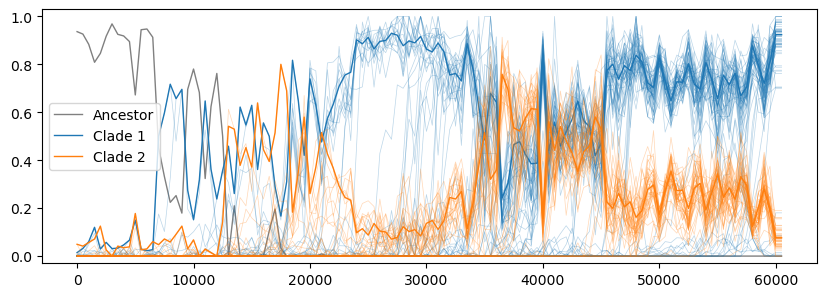

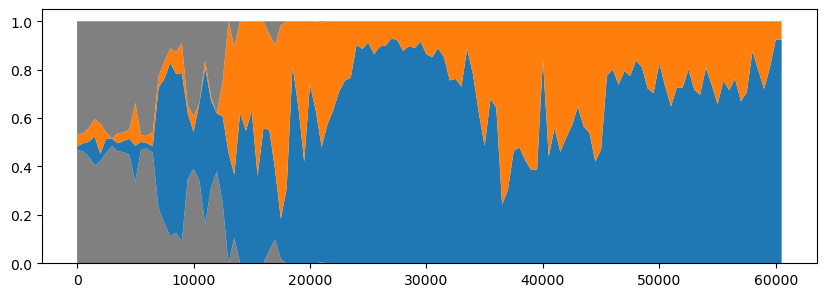

In [22]:
reconstruction = LH.reconstructForAPopulationAsOnePeriod(pop, 
    groups=groups, plot=True)

<------------------------------------------------------------------------------------------>
> Initializing variables...	took: 0.000102s
Reconstructing... took 49.704s
No clade getting fixed. Treating the entire evolution as a whole competition period.  


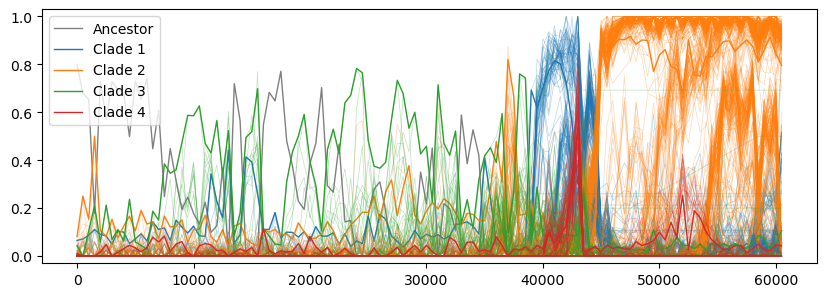

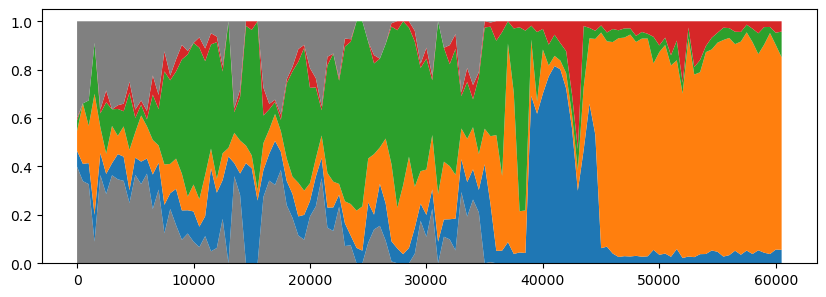

CPU times: user 55.1 s, sys: 1.89 s, total: 57 s
Wall time: 57.6 s


In [28]:
%%time
reload()
pop = 'm3'
groups = LH.load_clusterization_for_LTEE(pop)
reconstruction = LH.reconstructForAPopulationAsOnePeriod(pop, 
    groups=groups, plot=True)

<------------------------------------------------------------------------------------------>
> Initializing variables...	took: 0.000410s
> Using saved groups from previous computation...
  shared    group 1    group 2    group 3    group 4    group 5
    1447        688        652        267        109         85

> Forming groups from dxdx matrix...
  shared    group 1    group 2    group 3    group 4    group 5
     605        896        652        499        417        179
> Automatically set numClades=5


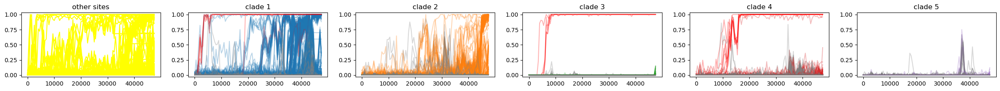

> Reclassifying mutations...
> Excluding shared mutations...
	clade 1 percent 0.5000 score threshold 0.0417 mean score 0.0347
	clade 2 percent 0.5000 score threshold 0.0463 mean score 0.0415
	clade 3 percent 0.5000 score threshold -0.0026 mean score 0.0066
	clade 4 percent 0.5000 score threshold 0.0097 mean score 0.0097
> 	excluded 148 mutations
  clade 1    clade 2    clade 3    clade 4    shared    fixed    minor    extinct    excluded
      166        239         14          2       111      131        0       2437         148
> Incorporating other mutations...
	clade 1 percent 0.5000 score threshold 0.0534, incorporates mutations [2052, 2284, 2818, 1482, 1293, 499, 1644, 976, 990, 2972, 2096, 1076, 1082, 419, 156, 1876, 1875, 1238, 536, 1559, 2957, 2272, 3053, 428, 2960, 2380, 2594, 542, 2869, 743, 995, 2821, 870, 2495, 2261, 2908, 627, 1563, 3219, 347, 485, 2373, 346, 848, 1454, 3075, 475, 2313, 3149, 2460, 685, 1335, 920, 889, 484, 2087, 2524, 1083, 526, 2231, 2286, 395, 1674, 25

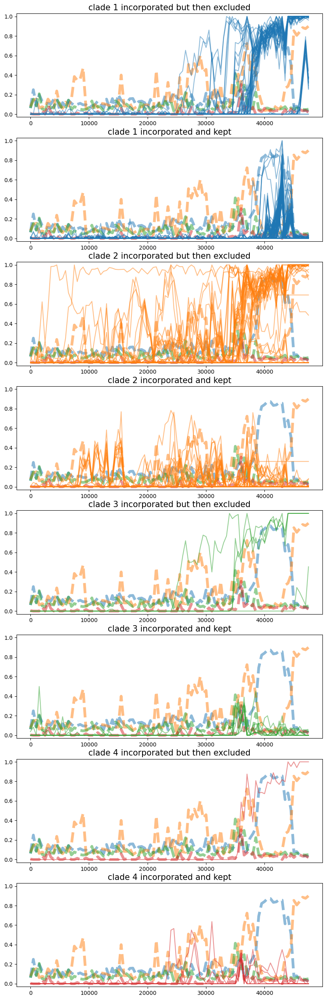

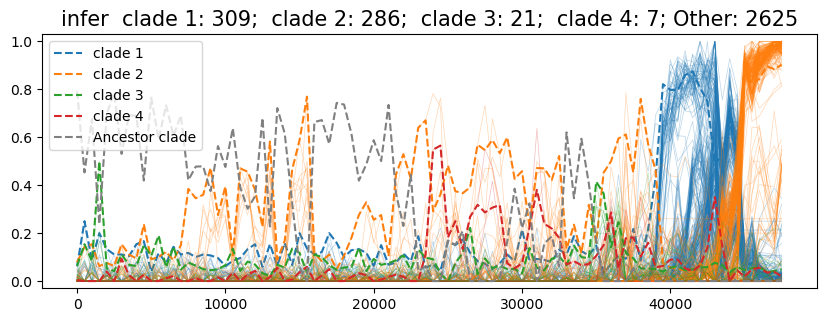

> Final clade info...
  clade 1    clade 2    clade 3    clade 4    other    total
      309        286         21          7     2625     3248

> Forming groups from dxdx matrix...
  shared    group 1    group 2    group 3    group 4    group 5    group 6
     897       1033        663        453         71         67         64
> Automatically set numClades=5


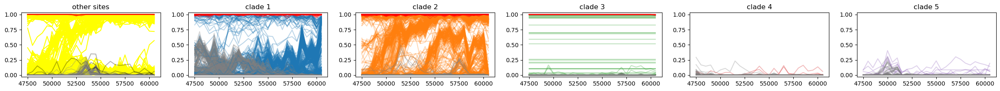

> Reclassifying mutations...
	clade 1 percent 0.5000 score threshold 0.0144
mut 139, prob [-98.         -29.39647068 -27.76838401 -98.         -98.        ], num_times 7
mut 2654, prob [-42.          -1.17158247  -1.09824184 -42.         -42.        ], num_times 3
mut 232, prob [-38.62225077  -3.60015479  -3.2323936  -42.         -42.        ], num_times 3
mut 1038, prob [-42.          -1.33110201  -1.19078594 -42.         -42.        ], num_times 3
mut 3088, prob [-42.   1.   1. -42. -42.], num_times 3
mut 1562, prob [-33.68554556   1.           1.         -42.         -34.23089679], num_times 3
mut 1244, prob [-29.2663312    1.           1.         -42.         -37.70793887], num_times 3
mut 3030, prob [-35.12887135   1.           1.         -42.         -35.44719998], num_times 3
mut 2687, prob [-42.   1.   1. -42. -42.], num_times 3
mut 31, prob [-42.           1.           1.         -42.         -41.08197237], num_times 3
mut 2148, prob [-40.00718426   1.           1.         -42

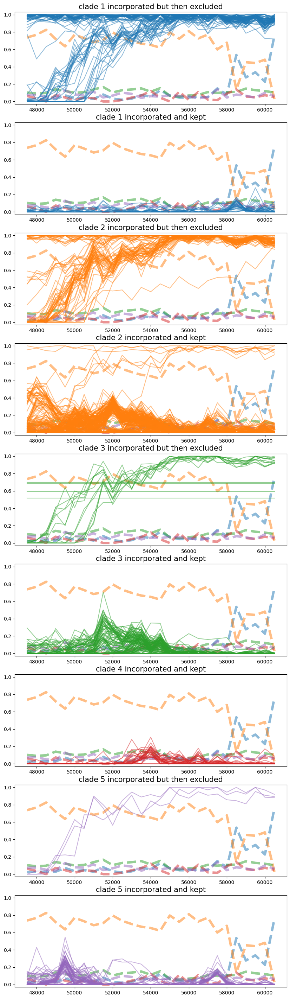

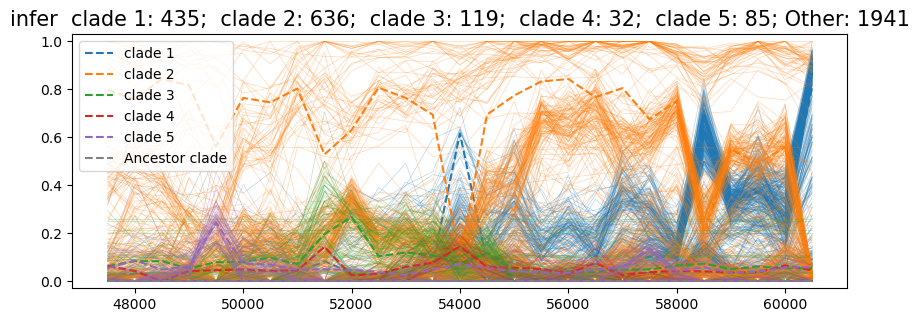

> Final clade info...
  clade 1    clade 2    clade 3    clade 4    clade 5    other    total
      435        636        119         32         85     1941     3248
Running removeInferredSubcladeBeforeFixation()... period 0 length: 96 cladeFreq at the end = [0.02747412 0.90297551 0.04903657 0.02051379] threshold = 0.99 - 0.02 = 0.97
(0-indexed) clade 2 freq at the end 0.04903657088946894 0.052361563774119914 < 0.05259460006923228 ?
(0-indexed) cladesToModify: [0]
(0-indexed) cladesToRemove: [2]


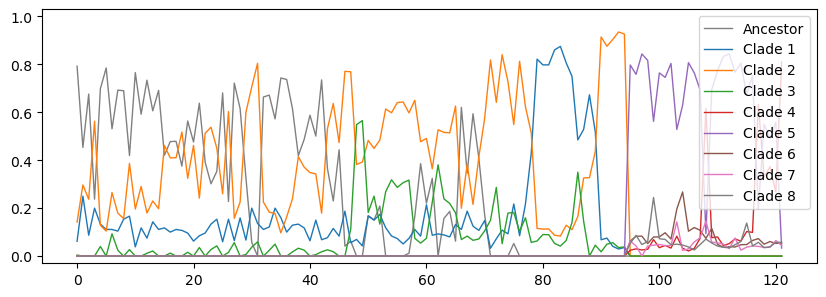

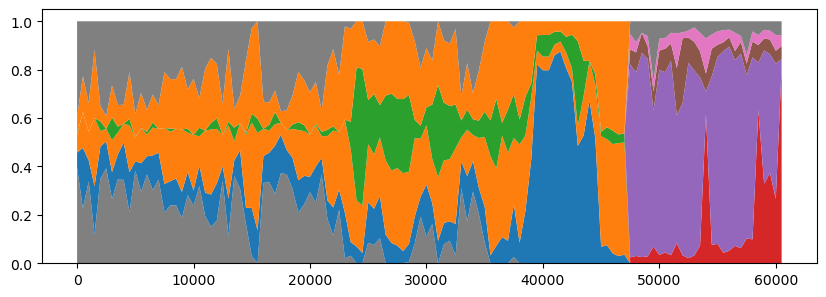


> Forming groups from dxdx matrix...
  shared    group 1    group 2
       4       2827        417
> Automatically set numClades=2


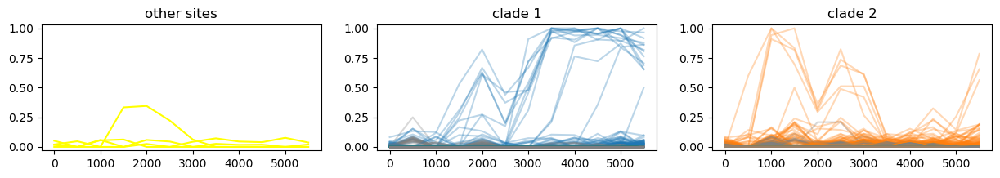

> Reclassifying mutations...
> Excluding shared mutations...
  clade 1    clade 2    shared    fixed    minor    extinct    excluded
       28         50         2        0        0       3168           0
> Incorporating other mutations...
	clade 1 percent 0.5000 score threshold 0.0027, incorporates mutations [717, 1425, 759, 1101, 2313, 482, 1323, 842, 914, 749, 280]
	clade 2 percent 0.5000 score threshold 0.0010, incorporates mutations [2575, 1057, 615, 221, 3233, 259, 3122, 2882, 2132, 1885, 1263, 997, 1298, 2369, 2848, 555, 152, 2147, 54, 819, 328, 1064, 2616, 1077, 1275, 650, 195, 3056, 507, 3078, 870, 1661, 2121, 1523, 2077, 2562, 2953]
> incorporated 48 mutations
> Excluding shared mutations again...


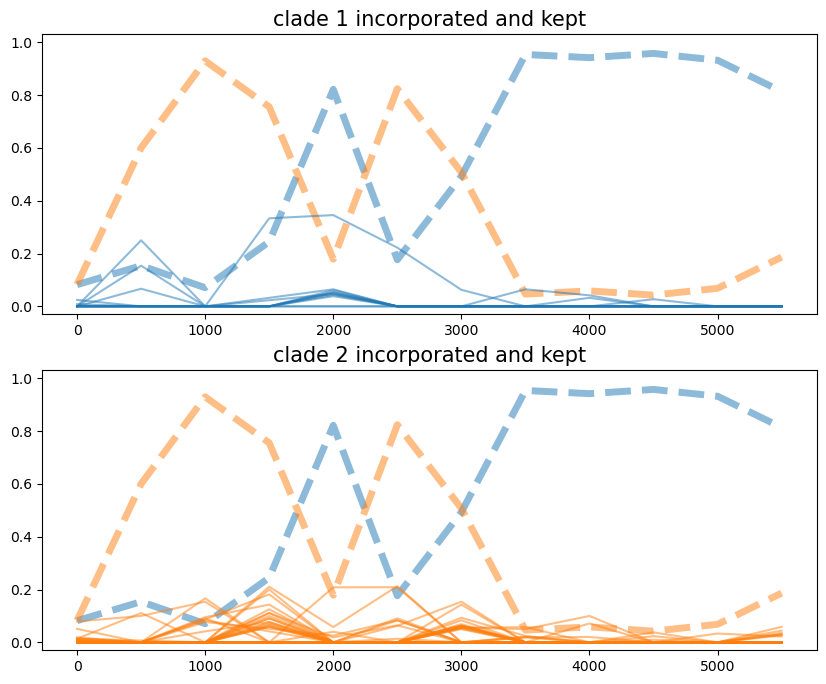

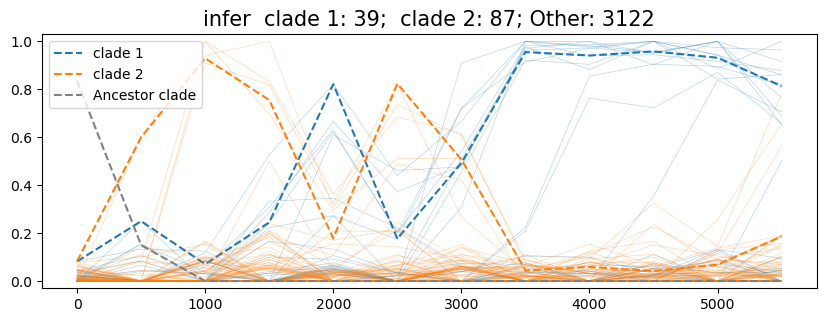

> Final clade info...
  clade 1    clade 2    other    total
       39         87     3122     3248

> Forming groups from dxdx matrix...
  shared    group 1    group 2    group 3    group 4    group 5
    1443        685        654        272        109         85
> Automatically set numClades=4


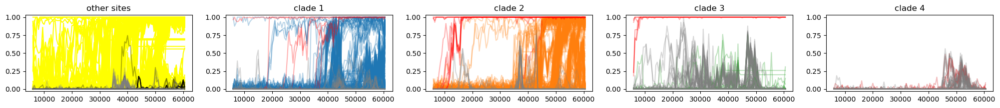

> Reclassifying mutations...
	clade 1 percent 0.5000 score threshold 0.0390
mut 1935, prob [-266.          -50.02979274 -266.         -266.        ], num_times 19
mut 1326, prob [-84.         -10.61563461 -84.         -84.        ], num_times 6
mut 663, prob [-252.          -64.61057829 -252.         -252.        ], num_times 18
mut 3030, prob [-32.10676723  -0.99128516 -27.5123261  -37.96995977], num_times 3
mut 1562, prob [-39.33955357   1.         -41.57176354 -42.        ], num_times 3
mut 2708, prob [-36.88406987   1.         -20.76015169 -13.50708354], num_times 3
	clade 3 percent 0.5000 score threshold 0.0181
mut 3209, prob [-39.92415526  -2.46087167 -36.84325083 -42.        ], num_times 3
> 	reclassified 7 mutations
> Excluding shared mutations...
	clade 1 percent 0.5000 score threshold 0.0399 mean score 0.0412
	clade 2 percent 0.5000 score threshold 0.0378 mean score 0.0306
	clade 3 percent 0.5000 score threshold 0.0311 mean score 0.1622
	clade 4 percent 0.5000 score threshold

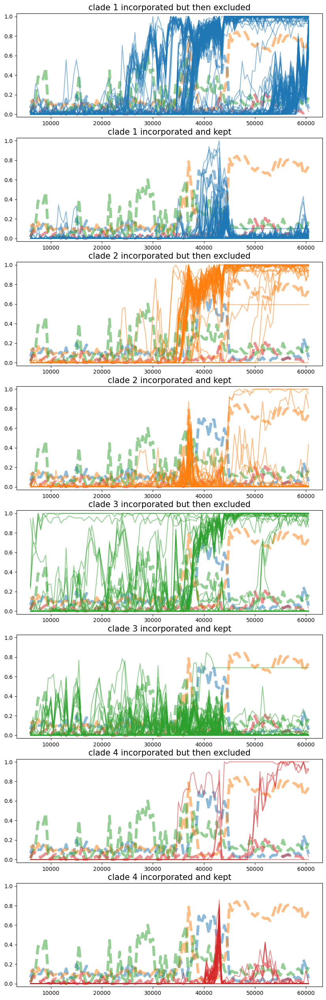

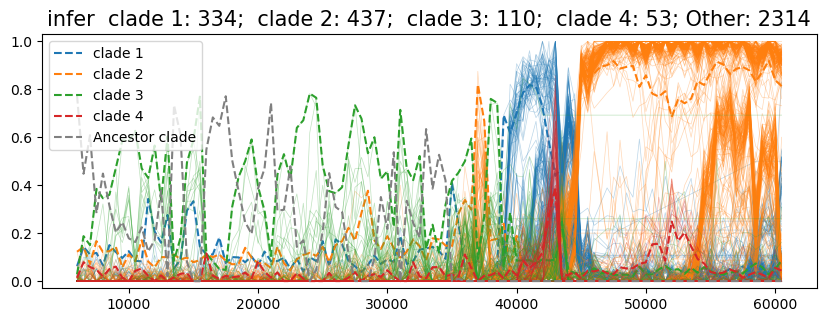

> Final clade info...
  clade 1    clade 2    clade 3    clade 4    other    total
      334        437        110         53     2314     3248
cladeFixedTimes = [95]
period boundaries:  [(0, 96), (95, 122)]
ancestors:  [0, 2, 4]
refined period boundaries:  [(0, 12), (12, 122)]
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in ti

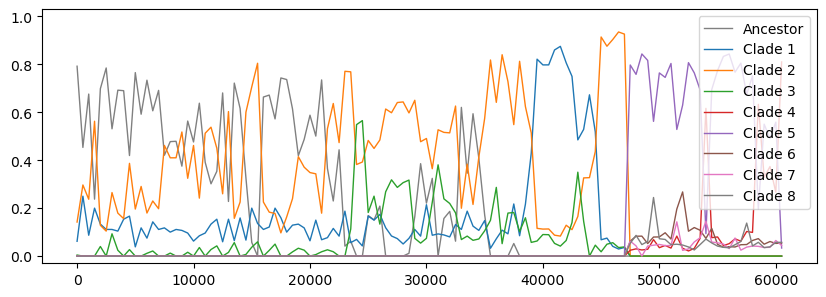

clade 2 unconnected at 94
clade 5 unconnected at -95
>Trying assemble clade 1 in period 0 and clade 1 in period 1...
Can seamlessly connect? (0.12881472445994246 < 0.05? ) False
clade 2 unconnected at 94
clade 5 unconnected at -95
Removed clades are:  {5}


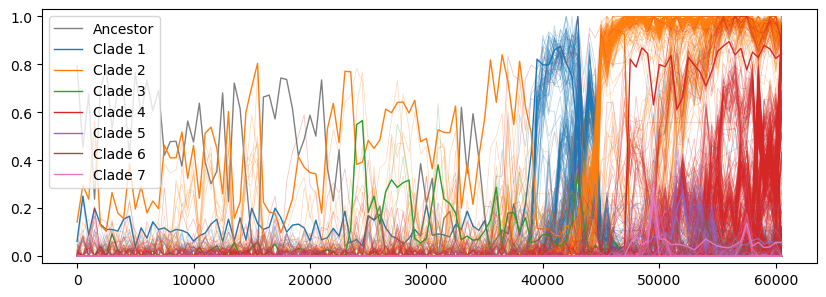

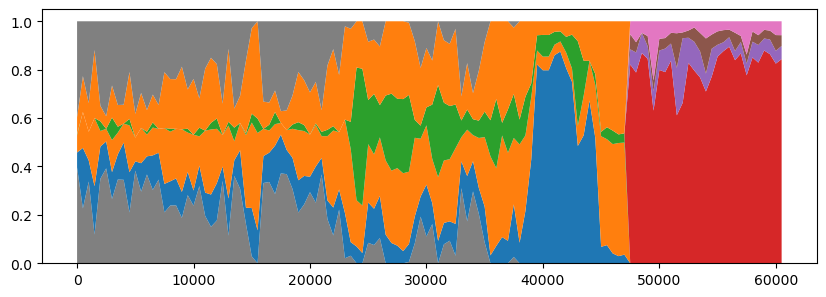

CPU times: user 1h 43s, sys: 1min 8s, total: 1h 1min 51s
Wall time: 1h 2min 43s


In [29]:
%%time
reload()
pop = 'm3'
groups = LH.load_clusterization_for_LTEE(pop)
reconstruction = LH.reconstructForAPopulation(pop, 
    groups=groups, debug=True, verbose=True, timing=True, plot=True, 
    cladeFixedTimes=[95])

<------------------------------------------------------------------------------------------>
> Initializing variables...	took: 0.000395s
> Using saved groups from previous computation...
  shared    group 1    group 2    group 3    group 4    group 5
    1447        688        652        267        109         85

> Forming groups from dxdx matrix...
  shared    group 1    group 2    group 3    group 4    group 5
     605        896        652        499        417        179
> Automatically set numClades=5


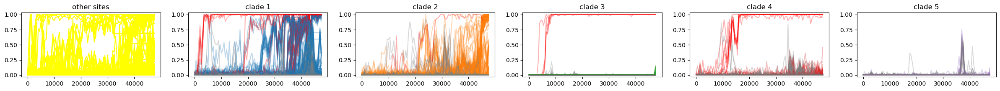

> Reclassifying mutations...
	clade 1 percent 0.5000 score threshold 0.0496
mut 658, prob [-42.   1. -42. -42.], num_times 3
mut 205, prob [-42.   1. -42. -42.], num_times 3
mut 368, prob [-42.   1. -42. -42.], num_times 3
mut 2913, prob [-42.           1.         -38.70280158 -42.        ], num_times 3
mut 1578, prob [-42.   1. -42. -42.], num_times 3
mut 1918, prob [-42.           1.         -39.51601252 -42.        ], num_times 3
mut 929, prob [-42.   1. -42. -42.], num_times 3
mut 2892, prob [-42.   1. -42. -42.], num_times 3
mut 2465, prob [-42.   1. -42. -42.], num_times 3
mut 2364, prob [-42.   1. -42. -42.], num_times 3
mut 1073, prob [-42.   1. -42. -42.], num_times 3
mut 1972, prob [-42.   1. -42. -42.], num_times 3
mut 3012, prob [-42.   1. -42. -42.], num_times 3
> 	reclassified 13 mutations
> Excluding shared mutations...
	clade 1 percent 0.5000 score threshold 0.0511 mean score 0.0449
	clade 2 percent 0.5000 score threshold 0.0445 mean score 0.0383
	clade 3 percent 0.5000

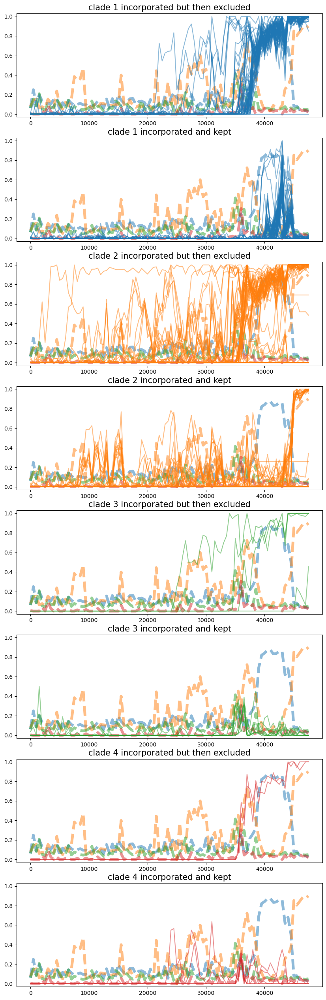

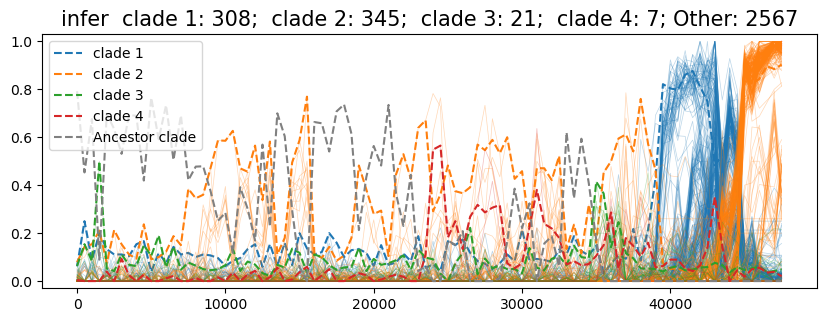

> Final clade info...
  clade 1    clade 2    clade 3    clade 4    other    total
      308        345         21          7     2567     3248

> Forming groups from dxdx matrix...
  shared    group 1    group 2    group 3    group 4    group 5    group 6
     897       1033        663        453         71         67         64
> Automatically set numClades=5


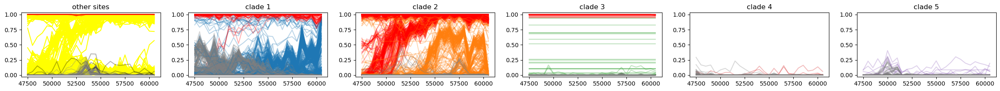

> Reclassifying mutations...
> Excluding shared mutations...
	clade 1 percent 0.5000 score threshold 0.0745 mean score 0.0598
	clade 2 percent 0.5000 score threshold 0.0421 mean score 0.0682
	clade 3 percent 0.5000 score threshold 0.0000 mean score 0.0001
	clade 4 percent 0.5000 score threshold 0.0036 mean score 0.0036
	clade 5 percent 0.5000 score threshold 0.0007 mean score 0.0005
> 	excluded 56 mutations
  clade 1    clade 2    clade 3    clade 4    clade 5    shared    fixed    minor    extinct    excluded
      422        218         16          2          6       143      671       64       1650          56
> Incorporating other mutations...
	clade 1 percent 0.5000 score threshold 0.0826, incorporates mutations [2071, 779, 2173, 950, 1878, 2484, 2581, 3153, 476, 1558, 848, 145, 1623, 2408, 1769, 3145, 1042, 1379, 1988, 1090, 3188, 2956, 1756, 395, 1674, 78, 2273, 3, 1277, 915, 816, 2823, 1719, 1824, 1272, 2514, 1779, 80, 3201, 3114, 1305, 2297, 1003, 342, 664, 492, 1884, 372, 270

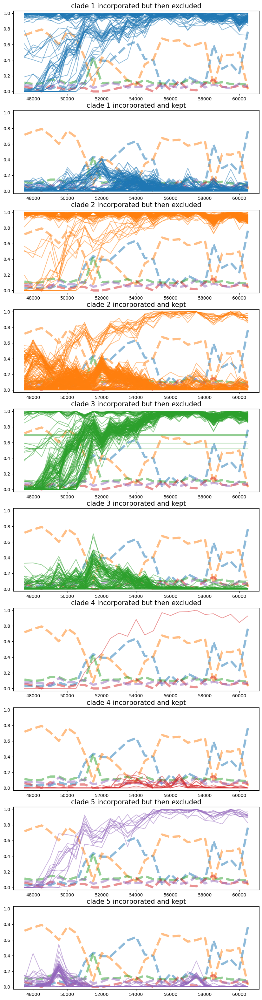

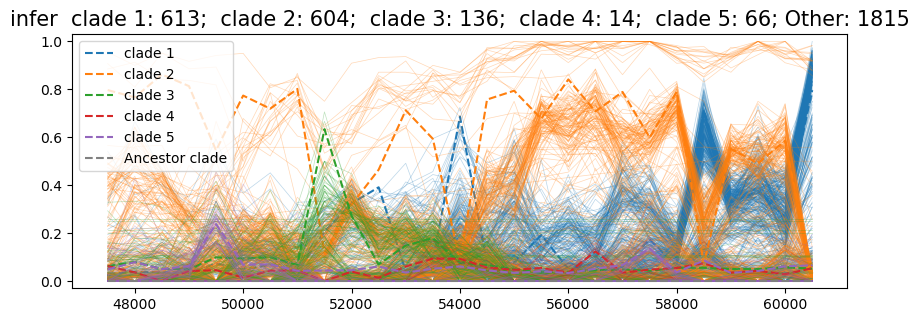

> Final clade info...
  clade 1    clade 2    clade 3    clade 4    clade 5    other    total
      613        604        136         14         66     1815     3248
Running removeInferredSubcladeBeforeFixation()... period 0 length: 96 cladeFreq at the end = [0.02747742 0.90296388 0.04904245 0.02051625] threshold = 0.95 - 0.02 = 0.9299999999999999
(0-indexed) clade 2 freq at the end 0.04904245127073633 0.05234044150875574 < 0.05255446776504034 ?
(0-indexed) cladesToModify: []
(0-indexed) cladesToRemove: [2]


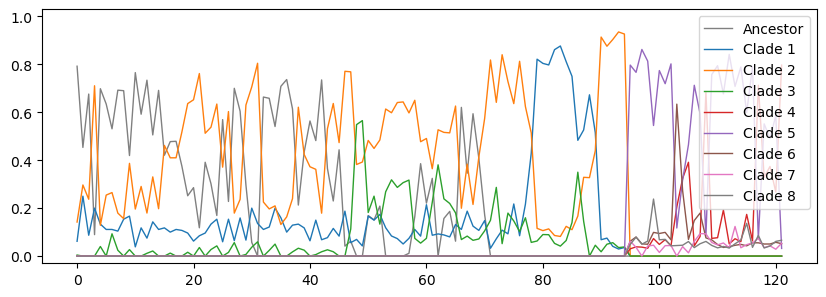

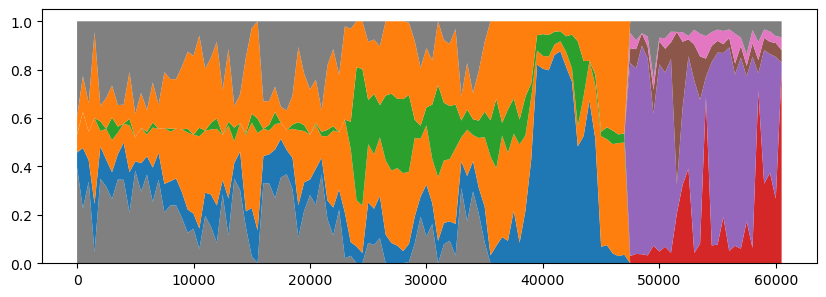


> Forming groups from dxdx matrix...
  shared    group 1    group 2
       4       2827        417
> Automatically set numClades=2


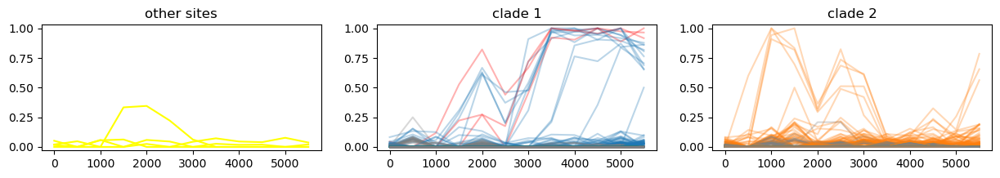

> Reclassifying mutations...
> Excluding shared mutations...
  clade 1    clade 2    shared    fixed    minor    extinct    excluded
       25         50         2        3        0       3168           0
> Incorporating other mutations...
	clade 1 percent 0.5000 score threshold 0.0017, incorporates mutations [1528, 415, 2856, 1425, 759, 1101, 2313, 482, 1243, 1323, 842, 914, 749, 221]
	clade 2 percent 0.5000 score threshold 0.0010, incorporates mutations [717, 2575, 1057, 3233, 259, 3122, 2882, 2132, 1263, 997, 2369, 2848, 152, 2147, 819, 1077, 650, 3056, 507, 870, 1661, 1536, 2121, 1523, 2105, 2077, 2562, 218, 2953, 100, 1397, 1477, 2649, 1910, 2315, 606]
> incorporated 50 mutations
> Excluding shared mutations again...


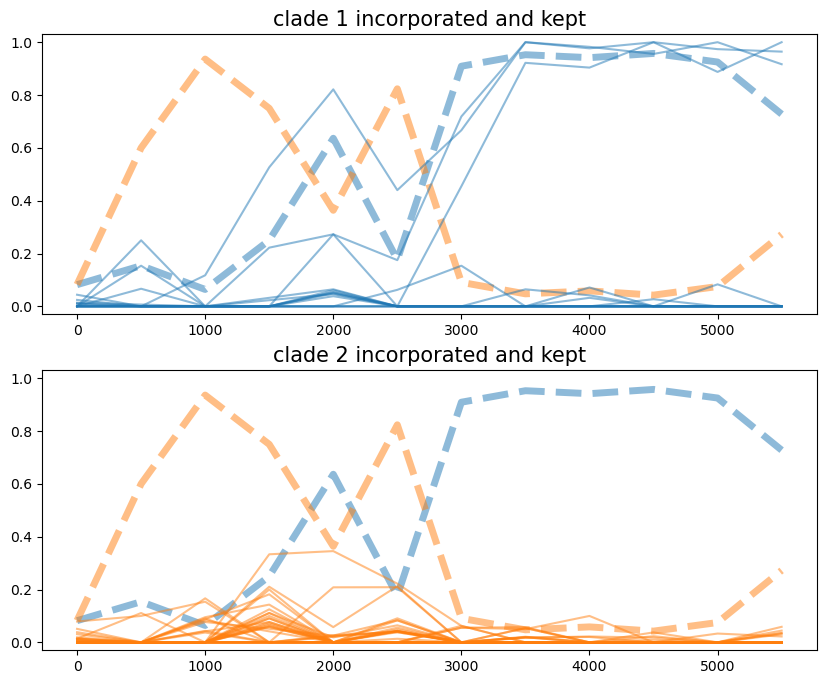

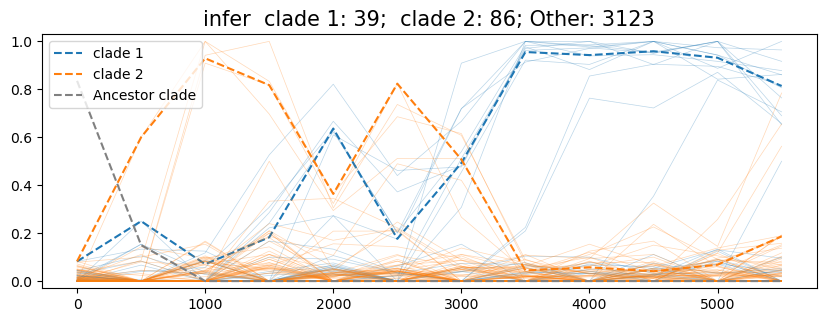

> Final clade info...
  clade 1    clade 2    other    total
       39         86     3123     3248

> Forming groups from dxdx matrix...
  shared    group 1    group 2    group 3    group 4    group 5
    1443        685        654        272        109         85
> Automatically set numClades=4


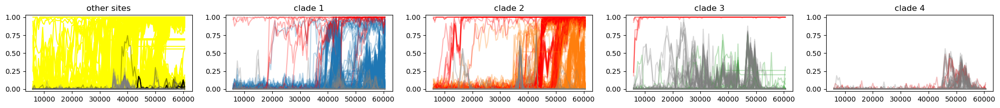

> Reclassifying mutations...
	clade 1 percent 0.5000 score threshold 0.0855
mut 2708, prob [-34.4268793   -2.62711722 -18.32370057  -8.91279086], num_times 3
> 	reclassified 1 mutations
> Excluding shared mutations...
	clade 1 percent 0.5000 score threshold 0.0856 mean score 0.0813
	clade 2 percent 0.5000 score threshold 0.1354 mean score 0.0985
	clade 3 percent 0.5000 score threshold 0.0179 mean score 0.1239
	clade 4 percent 0.5000 score threshold 0.0111 mean score 0.0114
> 	excluded 69 mutations
  clade 1    clade 2    clade 3    clade 4    shared    fixed    minor    extinct    excluded
      434        154          4          4        57      678       85       1763          69
> Incorporating other mutations...
	clade 1 percent 0.5000 score threshold 0.0826, incorporates mutations [2739, 2904, 52, 3183, 1878, 2148, 2372, 3041, 1082, 156, 1763, 1876, 565, 360, 3065, 797, 1119, 1238, 1875, 3210, 732, 1387, 1906, 1731, 2810, 2380, 2960, 10, 1650, 2853, 2990, 603, 1629, 1587, 564, 563

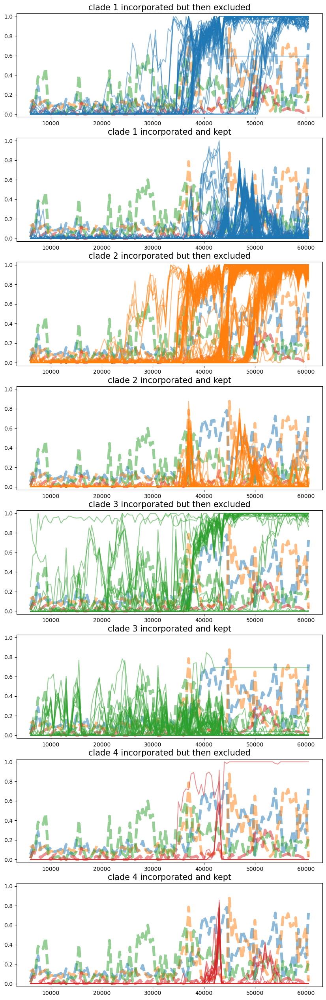

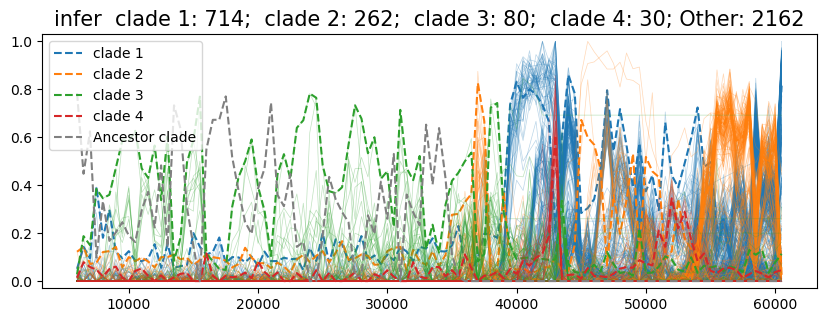

> Final clade info...
  clade 1    clade 2    clade 3    clade 4    other    total
      714        262         80         30     2162     3248
cladeFixedTimes = [95]
period boundaries:  [(0, 96), (95, 122)]
ancestors:  [0, 2, 4]
refined period boundaries:  [(0, 12), (12, 122)]
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in timepoints [12, 95). ancestorIndex=2
 Running amendConnectedCladeFreq()... for 1th period (0-indexed). Modifying cladeFreq in ti

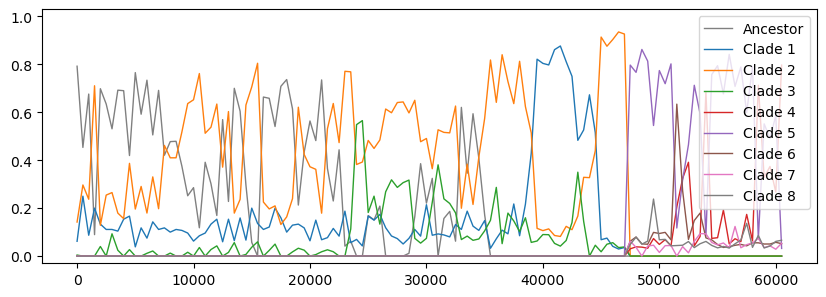

clade 2 unconnected at 94
clade 5 unconnected at -95
>Trying assemble clade 1 in period 0 and clade 1 in period 1...
Can seamlessly connect? (0.1295050098731163 < 0.05? ) False
clade 2 unconnected at 94
clade 5 unconnected at -95
Removed clades are:  {5}


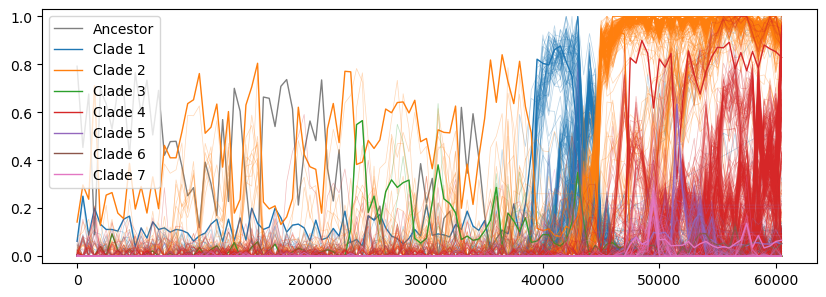

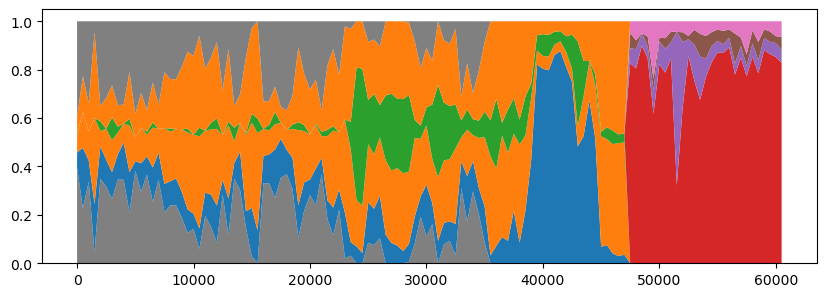

CPU times: user 1h 3min 2s, sys: 1min 23s, total: 1h 4min 25s
Wall time: 1h 5min 23s


In [31]:
%%time
reload()
pop = 'm3'
groups = LH.load_clusterization_for_LTEE(pop)
reconstruction = LH.reconstructForAPopulation(pop, 
    groups=groups, debug=True, verbose=True, timing=True, plot=True, 
    cladeFixedTimes=[95], thFixed=0.95)

### Dataset from Harris, K. B., Flynn, K. M. & Cooper, V. S. Polygenic Adaptation and Clonal Interference Enable Sustained Diversity in Experimental Pseudomonas aeruginosa Populations. Mol. Biol. Evol. 38, 5359–5375 (2021)

In [41]:
PALTEanalysis.df_traj.head(2)

,Unnamed: 0,X.1,X,X0,X17,X25,X44,X66,X75,X90,Population,Position,Mutation,Gene,Amino.Acid,Genotype
0,408,795,787,0,0.0,0.214,0.000,0.0,0.0,0.123,B2,5910265,G>C,aceE>/>aceF,Intergenic,genotype-27
1,206,794,437,0,0.0,0.000,0.109,0.0,0.0,0.109,B1,5910265,G>C,aceE>/>aceF,Intergenic,genotype-16


In [76]:
trajectories = {pop: None for pop in PALTEanalysis.POPULATIONS}
df = PALTEanalysis.df_traj
for pop in PALTEanalysis.POPULATIONS:
    print(f'Population {pop}', end='\t')
    trajectories[pop] = parse_interpolated_traj(df, pop)
    

Population B1	239 mutations	7 timepoints
Population B2	180 mutations	7 timepoints
Population B3	116 mutations	7 timepoints
Population P1	109 mutations	7 timepoints
Population P2	94 mutations	7 timepoints
Population P3	136 mutations	7 timepoints


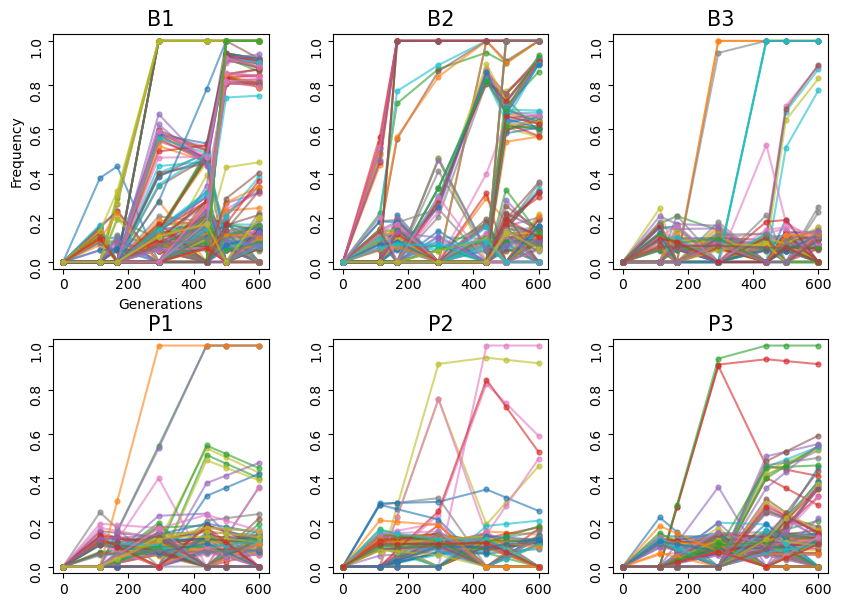

In [65]:
PALTEanalysis.plot_trajectories(trajectories, PALTEanalysis.POPULATIONS)

### Apply Lolipop (v0.9.0)

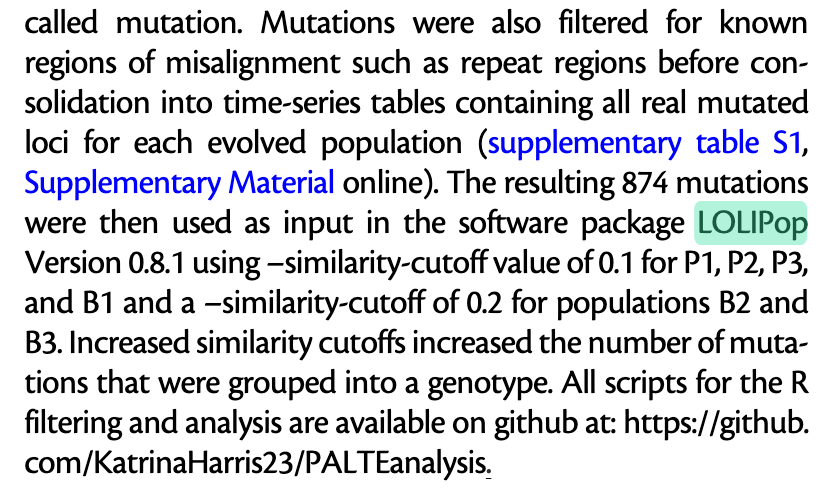

In [67]:
for pop in PALTEanalysis.POPULATIONS:
    traj = trajectories[pop]
    filename = f'{LOLIPOP_INPUT_DIR}/{pop}.tsv'
    lolipop_helper.saveTrajectoriesToTables(traj, filename, times=TIMES, sep='\t')
    

In [68]:
similarity_cutoffs = {
    'P1': 0.1,
    'P2': 0.1,
    'P3': 0.1,
    'B1': 0.1,
    'B2': 0.2,
    'B3': 0.2,
}
filename = 'lolipop_PALTEanalysis_data.sh'
with open(f'{LOLIPOP_JOBS_DIR}/{filename}', 'w') as fp:
    fp.write('#!/bin/sh\n')
    for pop in PALTEanalysis.POPULATIONS:
        similarity_cutoff = similarity_cutoffs[pop]
        fp.write(f"lolipop lineage --input {LOLIPOP_INPUT_DIR}/{pop}.tsv --output {LOLIPOP_OUTPUT_DIR}/{pop} --similarity-cutoff {similarity_cutoff}\n")


In [69]:
reload()
for pop in PALTEanalysis.POPULATIONS:
    directory = f'{LOLIPOP_OUTPUT_DIR}/{pop}'
    filename = f'{pop}'
    saveFile = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{filename}'
    lolipop_helper.parseOutput(directory, filename, saveFile=saveFile)

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [70]:
reload()
data_PALTEanalysis = {}
for pop in PALTEanalysis.POPULATIONS:
    file = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{pop}.npz'
    data_PALTEanalysis[pop] = lolipop_helper.loadParsedOutput(file)

In [71]:
titles = {}
for pop in PALTEanalysis.POPULATIONS:
    traj, genoTraj = data_PALTEanalysis[pop]['traj'], data_PALTEanalysis[pop]['genoTraj']
    numGenotypeInTheEnd = np.sum(genoTraj[-1, :] > 1e-2)
    numAlleleInTheEnd = np.sum(traj[-1, :] > 1e-2)
    titles[pop] = f'Genotypes = {numGenotypeInTheEnd}\nMutations = {numAlleleInTheEnd}'
    

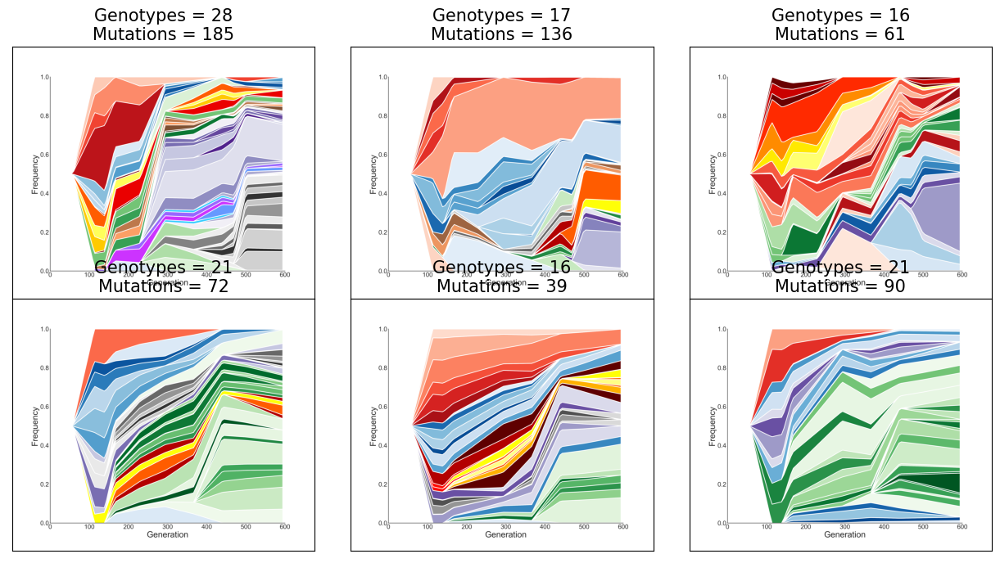

In [75]:
reload()
files = PALTEanalysis.parse_muller_files(PALTEanalysis.POPULATIONS)
PALTEanalysis.display_muller_plots(files, PALTEanalysis.POPULATIONS, titles=titles, wspace=0, hspace=0, figsize=(16, 8))


### Reconstcution

In [116]:
def reconstruct_for_a_PALTEanalysis_pop(pop, traj, times, plot=True, verbose=False):
    reload()
    (reconstruction, evaluation, inference) = PALTEanalysis.get_reconstruction_from_traj(traj, times, 
        mu=PALTEanalysis.MU, thFreqUnconnected=1, thFixed=0.98,
        evaluateReconstruction=True, evaluateInference=True, 
        plot=plot, verbose=verbose)
    return reconstruction, evaluation, inference


cladeFixedTimes = [3]
period boundaries:  [(0, 4), (3, 7)]
ancestors:  [0, 1, 5]
refined period boundaries:  [(0, 3), (3, 7)]


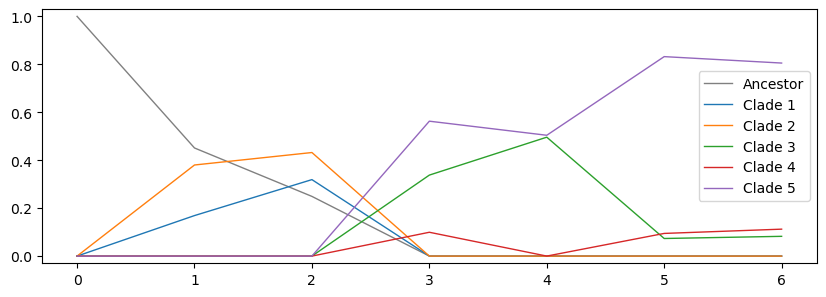

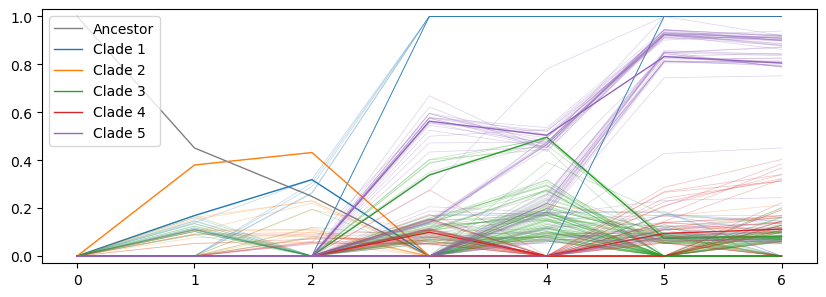

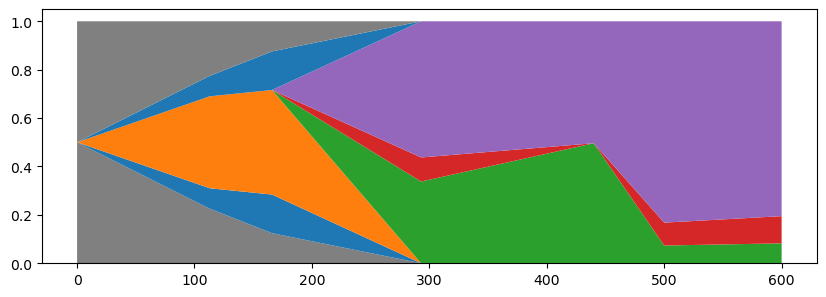

In [117]:
pop = 'B1'
reconstruction, evaluation, inference = reconstruct_for_a_PALTEanalysis_pop(pop, trajectories[pop], PALTEanalysis.TIMES)


/****************************** Pop B1 ******************************/
cladeFixedTimes = [3]
period boundaries:  [(0, 4), (3, 7)]
ancestors:  [0, 1, 5]
refined period boundaries:  [(0, 3), (3, 7)]


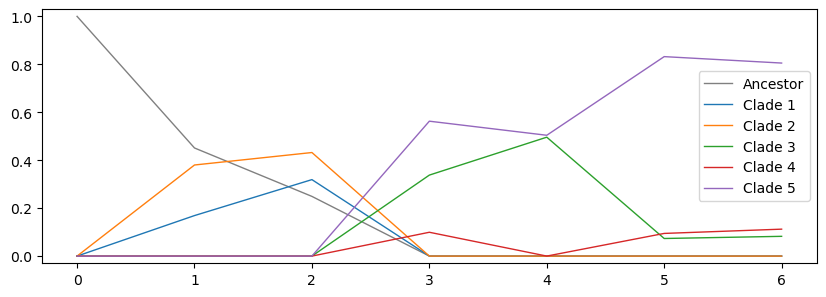

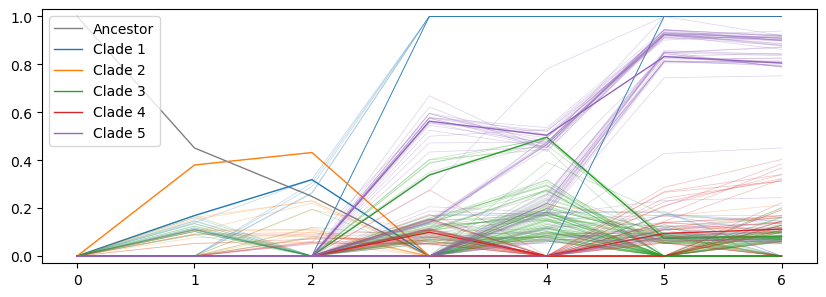

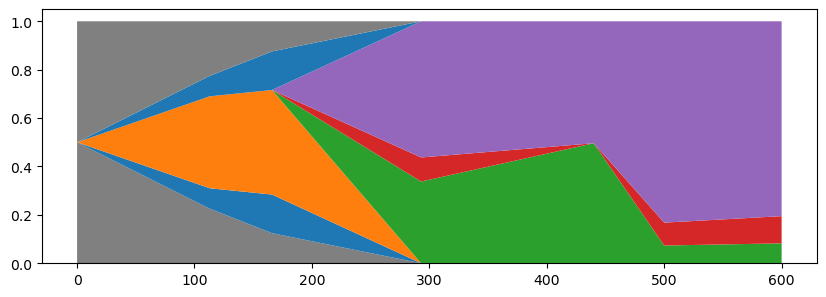

/****************************** Pop B2 ******************************/
cladeFixedTimes = [4]
period boundaries:  [(0, 5), (4, 7)]
ancestors:  [0, 1, 4]
refined period boundaries:  [(0, 3), (3, 7)]


/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


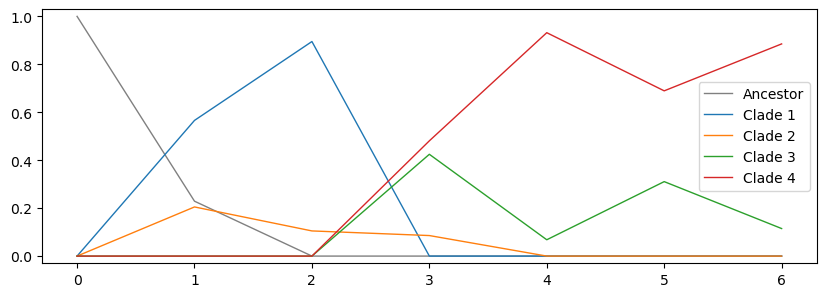

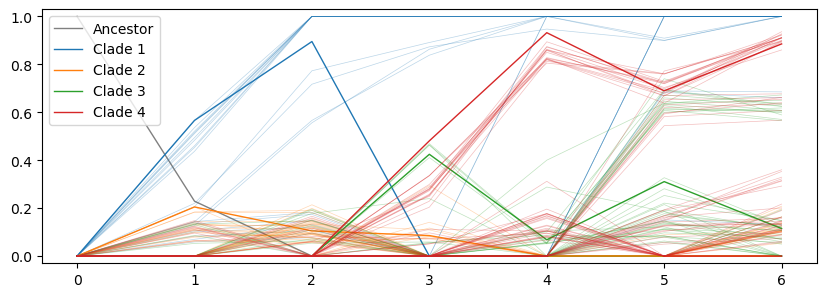

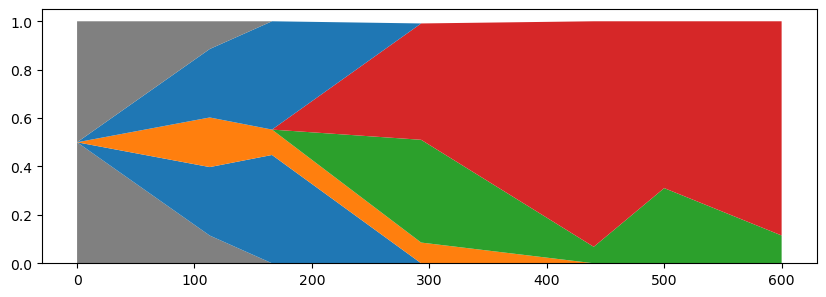

/****************************** Pop B3 ******************************/
cladeFixedTimes = [3]
period boundaries:  [(0, 4), (3, 7)]
ancestors:  [0, 1, 5]
refined period boundaries:  [(0, 1), (1, 7)]


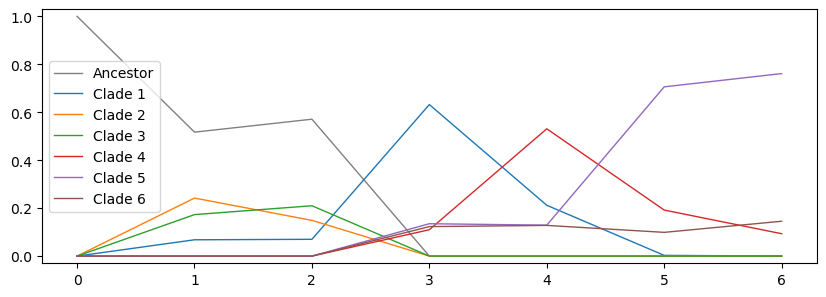

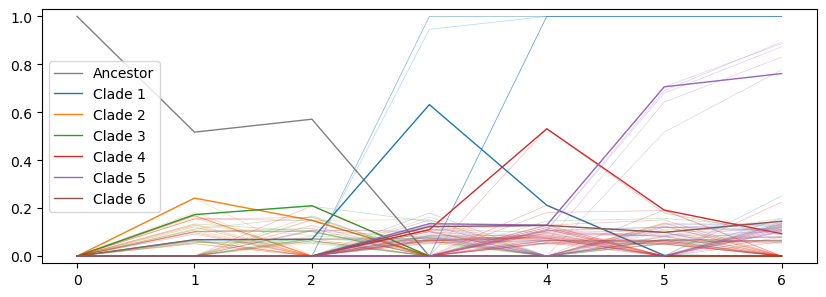

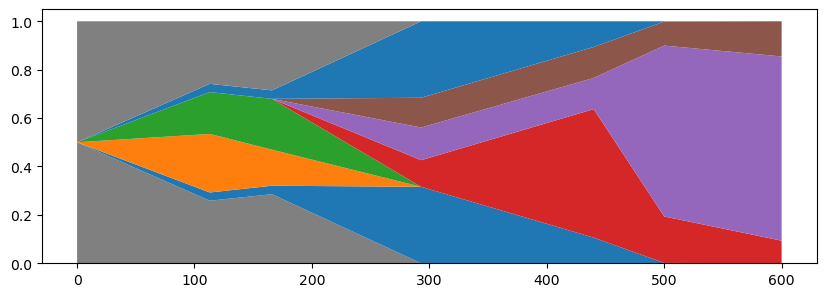

/****************************** Pop P1 ******************************/
cladeFixedTimes = [3]
period boundaries:  [(0, 4), (3, 7)]
ancestors:  [0, 1, 4]
refined period boundaries:  [(0, 2), (2, 7)]


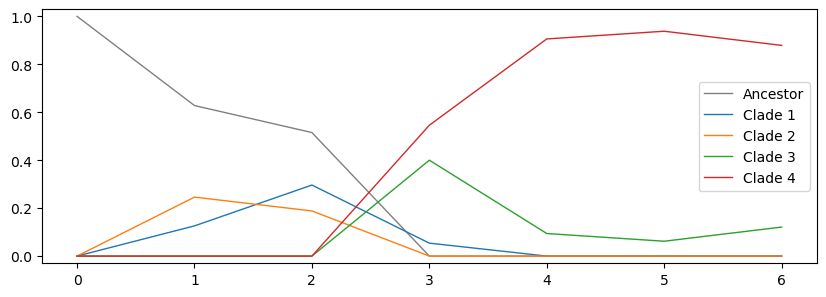

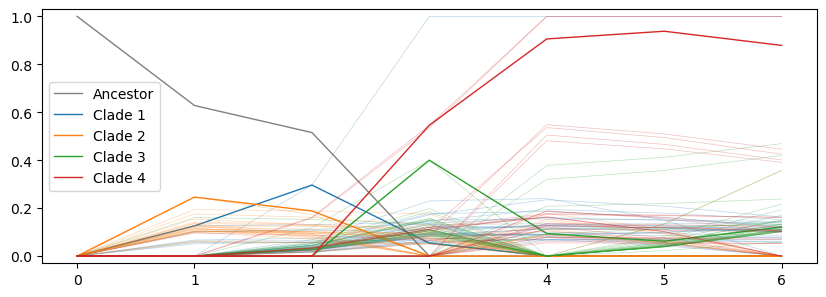

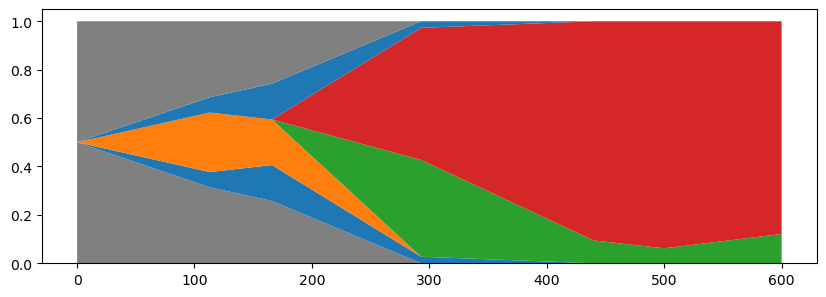

/****************************** Pop P2 ******************************/
cladeFixedTimes = [4]
period boundaries:  [(0, 5), (4, 7)]
ancestors:  [0, 2, 4]
refined period boundaries:  [(0, 2), (2, 7)]


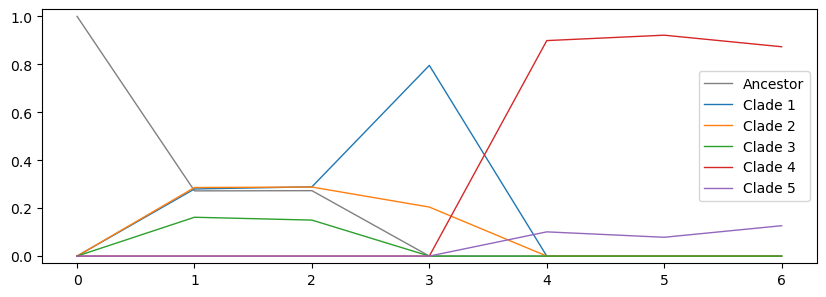

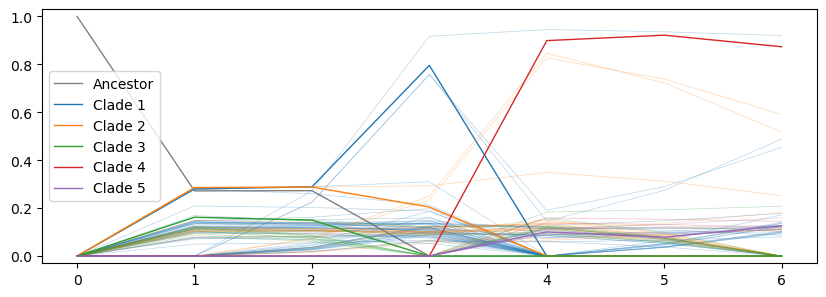

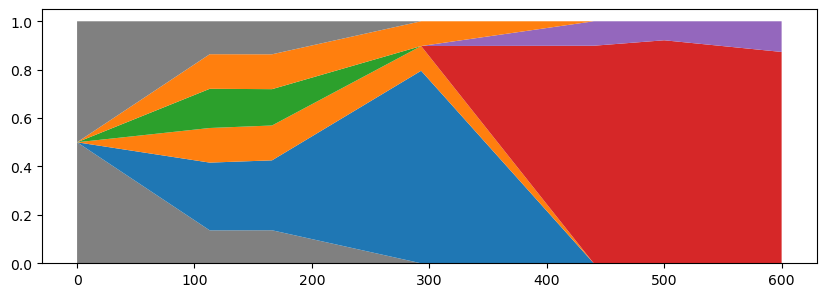

/****************************** Pop P3 ******************************/
cladeFixedTimes = [4]
period boundaries:  [(0, 5), (4, 7)]
ancestors:  [0, 1, 4]
refined period boundaries:  [(0, 1), (1, 7)]


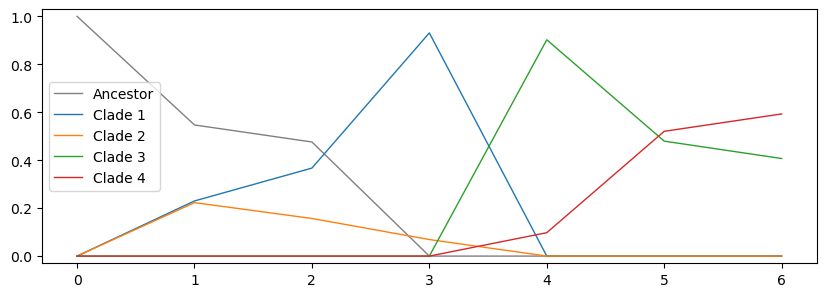

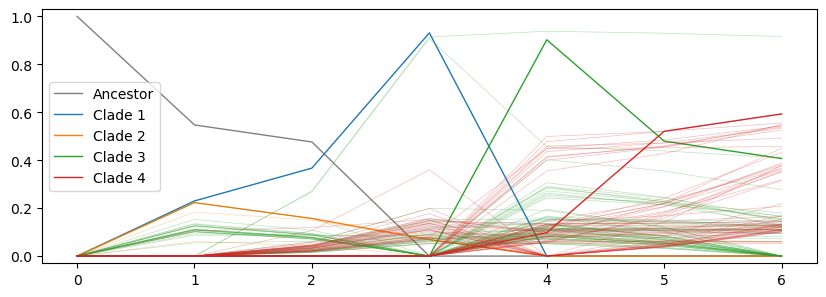

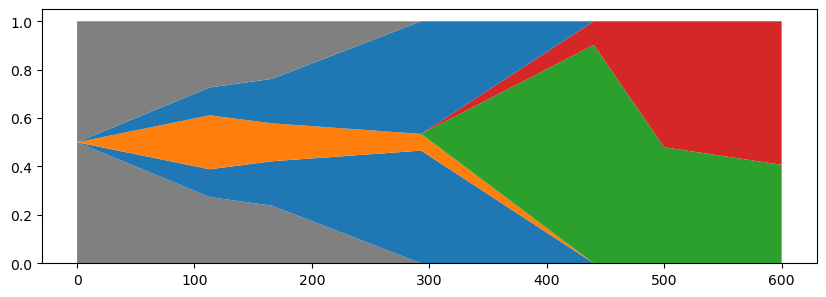

In [119]:
for pop in PALTEanalysis.POPULATIONS:
    print(f'/' + '*' * 30 + f' Pop {pop} ' + '*' * 30 + '/')
    reconstruction, evaluation, inference = reconstruct_for_a_PALTEanalysis_pop(pop, trajectories[pop], PALTEanalysis.TIMES)
    


### Datasets from ***Scribner, M. R., Santos-Lopez, A., Marshall, C. W., Deitrick, C. & Cooper, V. S. Parallel Evolution of Tobramycin Resistance across Species and Environments. MBio 11, (2020)***

In [125]:
medium, rpl = tobramycin_analysis.MEDIA[0], 0
tobramycin_analysis.df_pa_allele[medium][rpl].head(2)

,Unnamed: 0,10,12,3,4,6,7,9,0,Trajectory,Gene
0,fusA1 Q678L,90.7,100.0,65.3,100.0,100.0,100,91.0,0,1,fusA1 Q678L
1,orfK coding,13.5,54.6,0.0,64.6,77.7,89,51.2,0,2,orfK coding


### Apply Lolipop (v0.9.0)

In [128]:
# Create .sh job file
filename = 'lolipop_tobramycin_analysis_data.sh'
with open(f'{LOLIPOP_JOBS_DIR}/{filename}', 'w') as fp:
    fp.write('#!/bin/sh\n')
    for medium in tobramycin_analysis.MEDIA:
        for rpl in range(tobramycin_analysis.NUM_REPLICATES):
            fp.write(f"lolipop lineage --input {LOLIPOP_INPUT_DIR}/{medium}_{rpl+1}_mullerinput.csv --output {LOLIPOP_OUTPUT_DIR}/pa_{medium.lower()}_{rpl+1}\n")


In [129]:
reload()
for medium in tobramycin_analysis.MEDIA:
    for rpl in range(tobramycin_analysis.NUM_REPLICATES):
        directory = f'{LOLIPOP_OUTPUT_DIR}/pa_{medium.lower()}_{rpl+1}'
        filename = f'{medium}_{rpl+1}_mullerinput'
        saveFile = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{filename}'
        lolipop_helper.parseOutput(directory, filename, saveFile=saveFile)

/Users/yunxiao/anaconda3/lib/python3.6/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [146]:
reload()
data_tobramycin_analysis = {medium: [None for rpl in range(tobramycin_analysis.NUM_REPLICATES)] 
                            for medium in tobramycin_analysis.MEDIA}
for medium in tobramycin_analysis.MEDIA:
    for rpl in range(tobramycin_analysis.NUM_REPLICATES):
        file = f'{LOLIPOP_PARSED_OUTPUT_DIR}/{medium}_{rpl+1}_mullerinput.npz'
        data_tobramycin_analysis[medium][rpl] = lolipop_helper.loadParsedOutput(file)
        

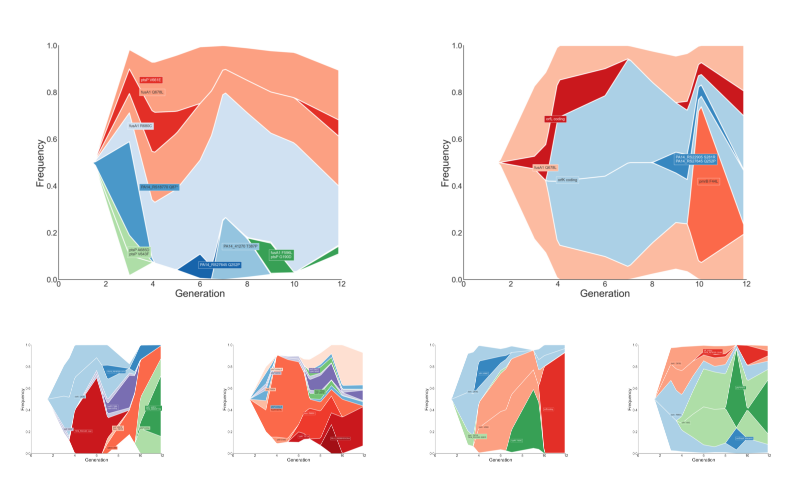

In [145]:
reload()
files = tobramycin_analysis.parse_muller_files()
tobramycin_analysis.display_muller_plots(files)


In [156]:
def inferForLolipop(muForInference=1e-6, regularization=1):
    intCov_lolipop, selection_lolipop, fitness_lolipop = {medium: [] for medium in media}, {medium: [] for medium in media}, {medium: [] for medium in media}
    for medium in media:
        for rpl in range(num_replicates):
            filename = f'{medium}_{rpl+1}_mullerinput'
            file = f'{parsed_output_dir}/{filename}.npz'
            data = lolipop_helper.loadParsedOutput(file)
            intCov, selection, fitness = lolipop_helper.inferencePipeline(data, mu=muForInference, regularization=regularization)

            intCov_lolipop[medium].append(intCov)
            selection_lolipop[medium].append(selection)
            fitness_lolipop[medium].append(fitness)
    return intCov_lolipop, selection_lolipop, fitness_lolipop


In [157]:
reload()
intCov_lolipop, selection_lolipop, fitness_lolipop = inferForLolipop(muForInference=1e-6, regularization=1)

### Reconstcution

In [147]:
def reconstruct_for_a_tobramycin_analysis_pop(medium, rpl, traj, times, plot=True, verbose=False):
    reload()
    (reconstruction, evaluation, inference) = tobramycin_analysis.get_reconstruction_from_traj(traj, times, 
        mu=tobramycin_analysis.MU, thFreqUnconnected=1, thFixed=0.98,
        evaluateReconstruction=True, evaluateInference=True, 
        plot=plot, verbose=verbose)
    return reconstruction, evaluation, inference


No clade getting fixed. Treating the entire evolution as a whole competition period.  


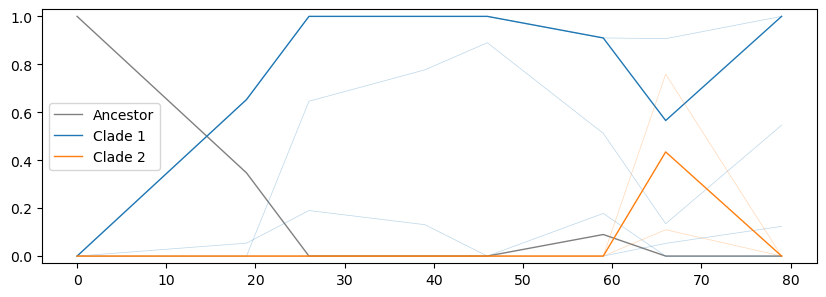

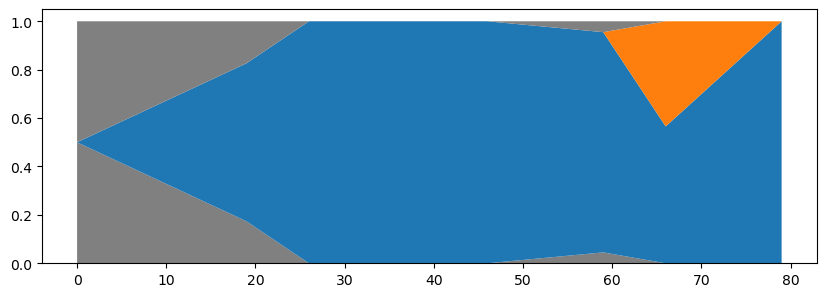

In [155]:
reload()
medium, rpl = 'Biofilm', 0
traj, times = tobramycin_analysis.traj_pa[medium][rpl][:2]
reconstruction, evaluation, inference = reconstruct_for_a_tobramycin_analysis_pop(medium, rpl, traj, times)


/****************************** Biofilm-1 ******************************/
No clade getting fixed. Treating the entire evolution as a whole competition period.  


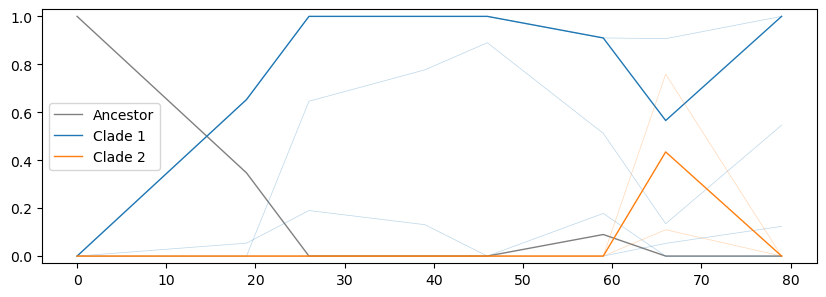

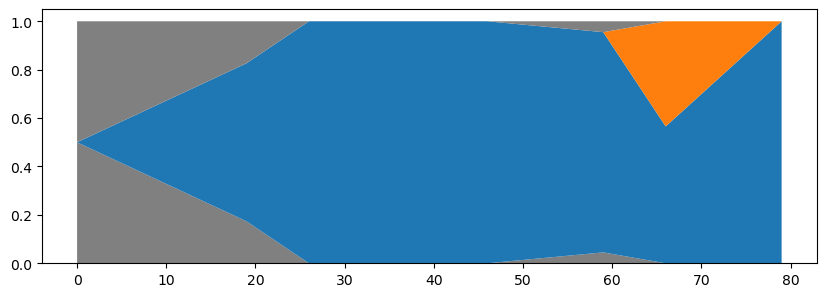

/****************************** Biofilm-2 ******************************/
No clade getting fixed. Treating the entire evolution as a whole competition period.  


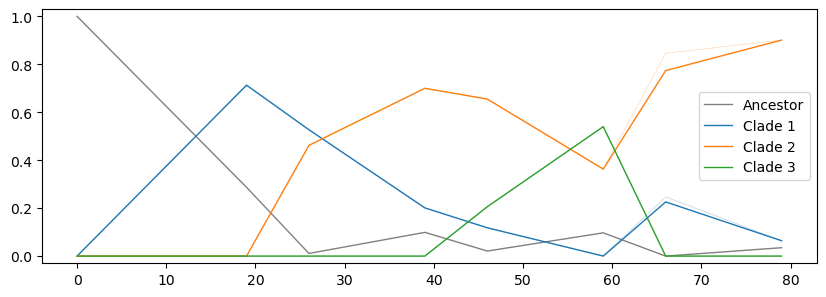

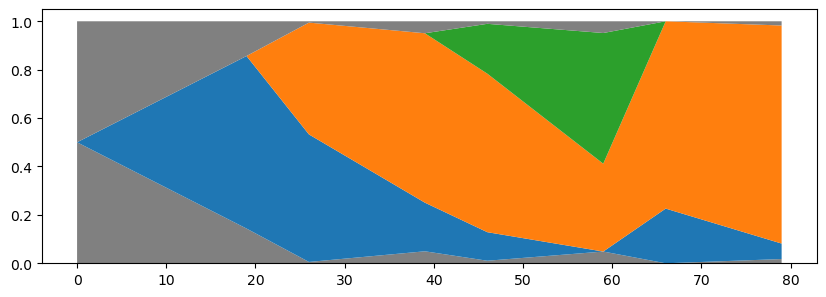

/****************************** Biofilm-3 ******************************/
No clade getting fixed. Treating the entire evolution as a whole competition period.  


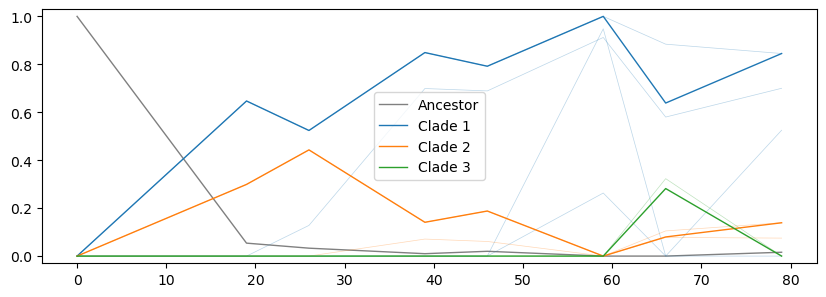

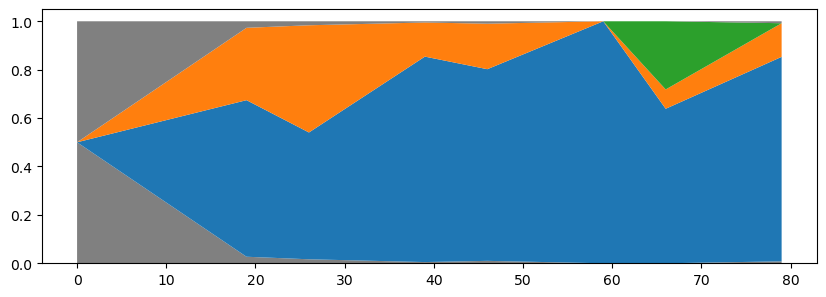

/****************************** Planktonic-1 ******************************/
No clade getting fixed. Treating the entire evolution as a whole competition period.  


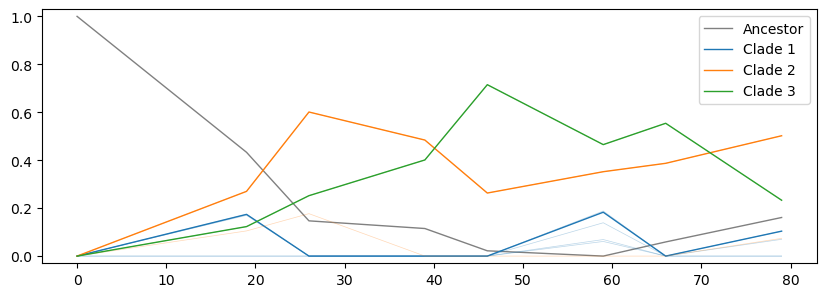

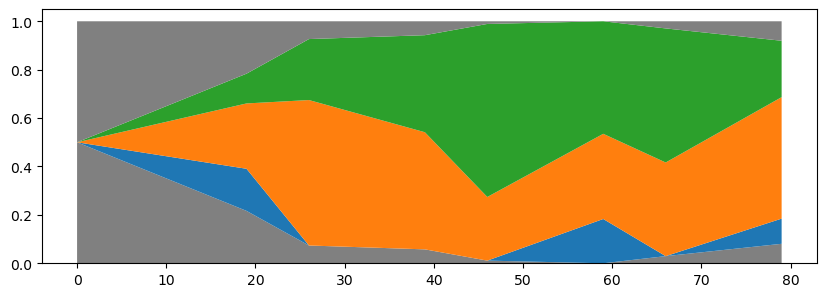

/****************************** Planktonic-2 ******************************/
No clade getting fixed. Treating the entire evolution as a whole competition period.  


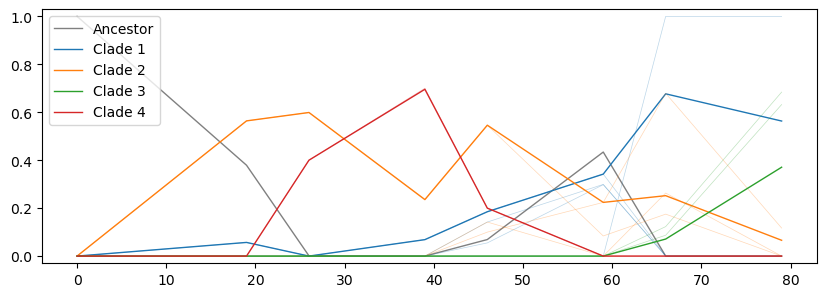

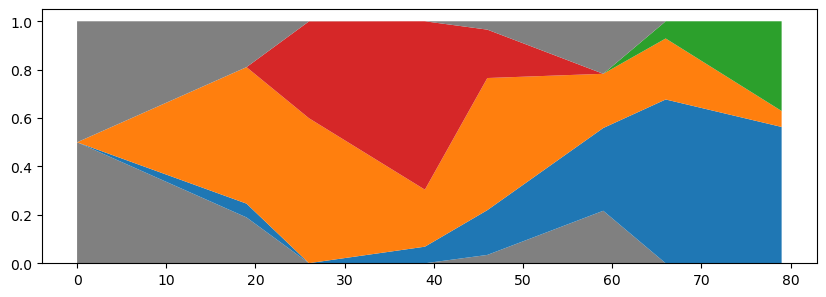

/****************************** Planktonic-3 ******************************/
No clade getting fixed. Treating the entire evolution as a whole competition period.  


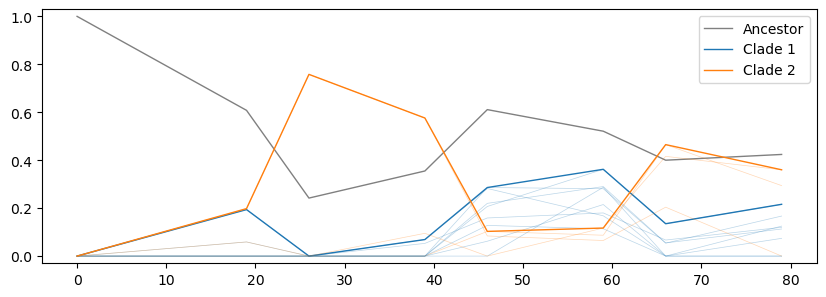

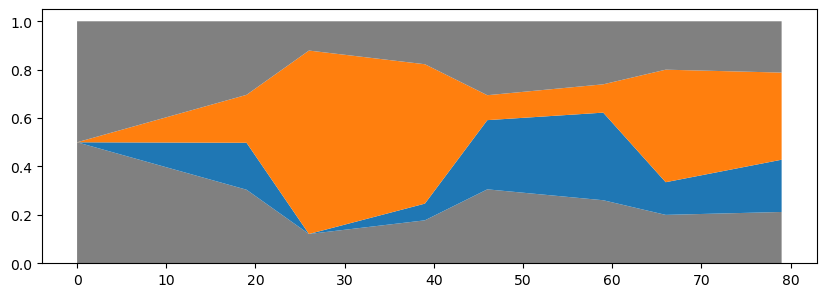

In [157]:
reload()
for medium in tobramycin_analysis.MEDIA:
    for rpl in range(tobramycin_analysis.NUM_REPLICATES):
        print(f'/' + '*' * 30 + f' {medium}-{rpl+1} ' + '*' * 30 + '/')
        traj, times = tobramycin_analysis.traj_pa[medium][rpl][:2]
        reconstruction, evaluation, inference = reconstruct_for_a_tobramycin_analysis_pop(medium, rpl, traj, times)
